In [2]:
import os
import sys
from itertools import combinations

from alphalens.tears import create_full_tear_sheet
from alphalens.utils import get_clean_factor_and_forward_returns

current_notebook_dir = os.getcwd()
project_root_path = os.path.dirname(os.path.dirname(current_notebook_dir))
sys.path.append(project_root_path)

import Chapter1.utils as chap1_utils 

In [3]:
chap1_utils.finlab_login()

輸入成功!


In [8]:
analysis_period_start_date = "2017-05-16"
analysis_period_end_date = "2021-05-15"

In [5]:
top_N_stocks = chap1_utils.get_top_stocks_by_market_value(
    excluded_industry=[
        "金融業",
        "金融保險業",
        "存托憑證",
        "建材營造"
    ],
    pre_list_date="2017-01-03"
)


Due to your status as a free user, the most recent data has been shortened or limited.
Daily usage: 0.9 / 500 MB - company_basic_info


In [6]:
len(top_N_stocks)

767

In [9]:
# 獲取指定股票代號列表在給定日期範圍內的每日收盤價資料
# 對應到財報資料時間 2017-Q1~2024-Q4
close_price_data = chap1_utils.get_daily_close_prices_data(
    stock_symbols=top_N_stocks,
    start_date=analysis_period_start_date,
    end_date=analysis_period_end_date
)

/Users/houguanyu/Documents/code/python/stock/Quant/PythonQuantrading/Chapter1/utils.py:101: FutureWarning: YF.download() has changed argument auto_adjust default to True
  full_data = yf.download(stock_symbols, start=start_date, end=end_date)
[*********************100%***********************]  767 of 767 completed


In [ ]:
# row 是 股票代號, column 是日期
close_price_data

Ticker,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9938,9939,9940,9941,9942,9943,9944,9945,9955,9958
Date,,,,,,,,,,,,,,,,,,,,,
2017-05-16,18.384672,18.150356,7.539372,14.896709,7.083519,7.315918,14.888120,16.288328,18.226238,17.267311,...,73.171822,55.701378,18.551880,34.819096,53.063354,36.075706,16.116508,13.548565,13.600000,8.173239
2017-05-17,18.227537,17.956924,7.432178,14.896709,7.053942,7.279521,14.934645,16.457998,18.264210,17.296778,...,73.542114,55.701378,18.338949,35.339981,53.129272,35.873409,15.869825,13.492190,13.700000,8.121069
2017-05-18,18.201347,17.763489,7.432178,14.896709,7.068730,7.315918,14.888120,16.161076,18.188269,17.031580,...,73.023689,54.987255,18.179247,35.460186,52.931522,35.873409,15.869825,13.379445,14.350000,8.147154
2017-05-19,18.070404,17.892450,7.360715,14.838970,7.061336,7.388714,14.888120,16.033825,18.302179,17.031580,...,73.097755,54.897991,17.992931,38.986168,53.129272,36.210571,15.869825,13.229113,14.100000,8.164544
2017-05-22,18.122778,17.602299,7.360715,14.752359,7.039155,7.315918,14.888120,15.991405,18.416096,17.473579,...,73.023689,54.630196,17.673532,42.872768,53.195187,36.278000,15.787600,13.172738,14.150000,8.208019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-10,40.280830,39.641411,21.521509,19.485487,14.409401,23.347269,16.278688,21.995188,32.471283,48.295811,...,84.667946,71.689476,24.664589,79.526306,76.902634,60.029022,17.409174,25.080170,23.600000,112.870918
2021-05-11,39.290943,39.018356,20.757431,18.161943,13.608879,21.395157,16.230955,21.300604,31.892235,47.258049,...,82.955750,69.145966,24.032162,77.212807,72.881050,59.122231,17.877390,24.712696,21.650000,106.881851
2021-05-12,37.768036,37.811203,19.441521,17.095758,12.247991,20.575268,14.607859,19.494682,30.288715,44.224594,...,74.994049,65.754608,23.362535,72.585823,68.613235,56.311211,19.665129,23.059059,19.549999,97.207207


In [14]:
close_price_data["2330"]

Date
2017-05-16    164.623367
2017-05-17    164.220840
2017-05-18    163.818375
2017-05-19    163.415817
2017-05-22    165.025864
                 ...    
2021-05-10    549.888794
2021-05-11    533.084106
2021-05-12    522.814575
2021-05-13    510.677734
2021-05-14    520.013733
Name: 2330, Length: 974, dtype: float64

In [18]:
# 列舉和收益成正相關的因子（根據單因子分析結果）
pos_corr_factors = [
    "營運現金流",
    "歸屬母公司淨利",
    "ROE稅後",
    "營業毛利成長率",
    "營業利益成長率",
    "稅前淨利成長率",
    "稅後淨利成長率",
]

In [19]:
# 從 Finlab 取得多個因子資料，並將這些資料儲存在 factors_data_dict 字典中，
# 字典的鍵為因子名稱，值為對應的因子數據
factor_data_dict = {}

for factor in pos_corr_factors:
    factor_data = (
        chap1_utils.get_factor_data(
            stock_symbols=top_N_stocks,
            factor_name=factor,
            trading_days=list(close_price_data.index)
        )
        .reset_index()
        .assign(factor_name=factor)
    )
    factor_data_dict[factor] = factor_data


Daily usage: 34.9 / 500 MB - fundamental_features:營業毛利成長率
Daily usage: 36.3 / 500 MB - fundamental_features:營業利益成長率
Daily usage: 37.7 / 500 MB - fundamental_features:稅前淨利成長率
Daily usage: 39.1 / 500 MB - fundamental_features:稅後淨利成長率


In [20]:
factor_data_dict['營業毛利成長率']

,datetime,asset,value,factor_name
0,2017-05-16,1101,89.121656,營業毛利成長率
1,2017-05-16,1102,-6.527748,營業毛利成長率
2,2017-05-16,1103,4080.630631,營業毛利成長率
3,2017-05-16,1104,20.412052,營業毛利成長率
4,2017-05-16,1108,-57.625689,營業毛利成長率
...,...,...,...,...
737313,2021-05-14,9943,2.868327,營業毛利成長率
737314,2021-05-14,9944,8.026765,營業毛利成長率
737315,2021-05-14,9945,18.212982,營業毛利成長率
737316,2021-05-14,9955,302.328641,營業毛利成長率


In [23]:
# 根據各個因子值（欄位：value）對股票進行排序
# 排序後的結果存放在 rank_factors_data_dict 字典中字典的鍵為因子名稱，值為排名結果。
rank_factors_data_dict = {}
for factor in factor_data_dict:
    rank_factors_data_dict[factor] = chap1_utils.rank_stocks_by_factor(
        factor_df=factor_data_dict[factor],
        positive_corr=True,
        rank_column="value",
        rank_result_column="rank"
    )

print(rank_factors_data_dict["營業利益成長率"])

         datetime asset       value factor_name   rank
0      2017-05-16  1101  301.255247     營業利益成長率  711.0
1      2017-05-16  1102    8.853618     營業利益成長率  401.0
2      2017-05-16  1103  126.614370     營業利益成長率  638.0
3      2017-05-16  1104   50.612799     營業利益成長率  534.0
4      2017-05-16  1108  -78.808291     營業利益成長率   86.0
...           ...   ...         ...         ...    ...
737313 2021-05-14  9943   18.347086     營業利益成長率  477.0
737314 2021-05-14  9944   91.629105     營業利益成長率  642.0
737315 2021-05-14  9945   42.643919     營業利益成長率  553.0
737316 2021-05-14  9955  110.188688     營業利益成長率  669.0
737317 2021-05-14  9958   25.099954     營業利益成長率  505.0

[737318 rows x 5 columns]


In [29]:
# 根據多個因子的排名和對應的全中，計算加權排名後，再依據加權排名結果將股票進行排序，
# combined_df_dict 用來儲存每個五因子組合的排序結果
pos_corr_factors_pair = list(combinations(pos_corr_factors, 5))
print(f"總計有 {len(pos_corr_factors_pair)} 個五因子組合")
print(f"所有五因子組合: {pos_corr_factors_pair}")

總計有 21 個五因子組合
所有五因子組合: [('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率'), ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率'), ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅後淨利成長率'), ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業利益成長率', '稅前淨利成長率'), ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業利益成長率', '稅後淨利成長率'), ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '稅前淨利成長率', '稅後淨利成長率'), ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率'), ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率'), ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率'), ('營運現金流', '歸屬母公司淨利', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率'), ('營運現金流', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率'), ('營運現金流', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率'), ('營運現金流', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率'), ('營運現金流', 'ROE稅後', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率'), ('營運現金流', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率'), ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率'), ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率'), ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率'), ('歸屬母公

In [30]:
combined_df_dict = {}
for pair in pos_corr_factors_pair:
    combined_df_dict[pair] = chap1_utils.calculate_weighted_rank(
        ranked_dfs=[
            rank_factors_data_dict[pair[0]],
            rank_factors_data_dict[pair[1]],
            rank_factors_data_dict[pair[2]],
            rank_factors_data_dict[pair[3]],
            rank_factors_data_dict[pair[4]],
        ],
        weights=[0.2, 0.2, 0.2, 0.2, 0.2], # 等權重
        positive_corr=True,
        rank_column="rank",
    ).set_index(["datetime", "asset"])

In [31]:
print(combined_df_dict[
    (
        "營運現金流",
        "ROE稅後",
        "營業利益成長率",
        "稅前淨利成長率",
        "稅後淨利成長率",
    )
])

                  weighted_rank
datetime   asset               
2017-05-16 1101           737.0
           1102           291.0
           1103           588.5
           1104           381.0
           1108           119.0
...                         ...
2021-05-14 9943           605.0
           9944           568.0
           9945           536.0
           9955           554.5
           9958           424.0

[737318 rows x 1 columns]


pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.501853,43.878619,147896,20.079424
2,153.0,304.0,228.009657,43.592246,146933,19.948680
3,304.0,455.0,379.342071,43.778156,147557,20.033399
4,455.0,606.0,530.446916,43.463407,146493,19.888942
5,606.0,757.0,681.612476,43.813279,147676,20.049555


Returns Analysis


,1D
Ann. alpha,0.018
beta,-0.020
Mean Period Wise Return Top Quantile (bps),0.631
Mean Period Wise Return Bottom Quantile (bps),-0.488
Mean Period Wise Spread (bps),1.119


<Figure size 640x480 with 0 Axes>

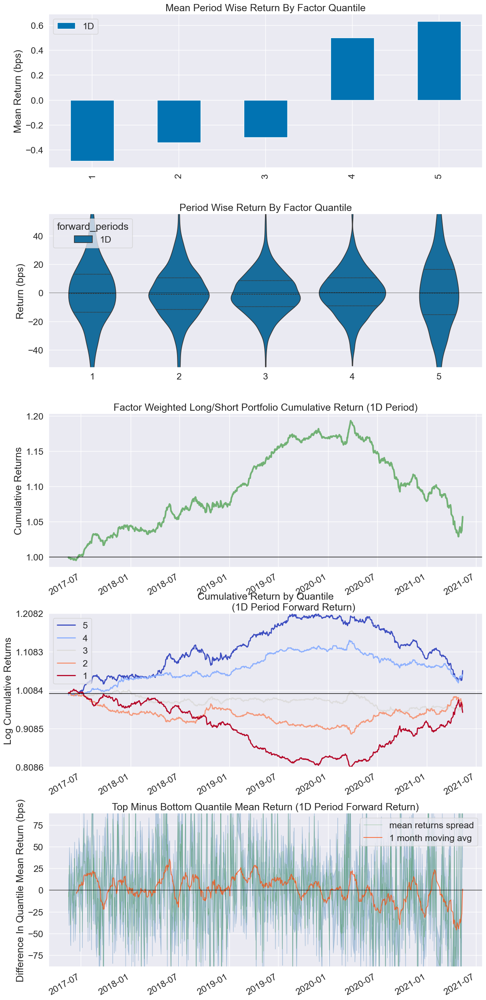

Information Analysis


,1D
IC Mean,0.019
IC Std.,0.078
Risk-Adjusted IC,0.247
t-stat(IC),7.708
p-value(IC),0.000
IC Skew,0.160
IC Kurtosis,0.213


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


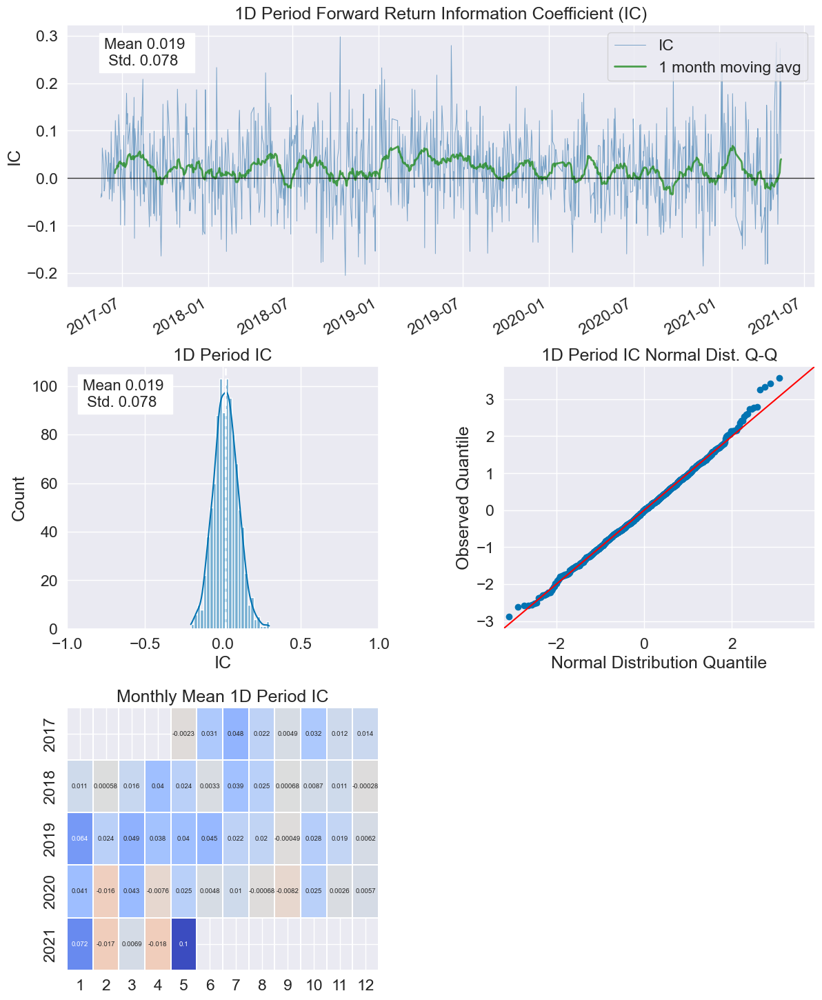

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.005
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.005
Quantile 5 Mean Turnover,0.003


,1D
Mean Factor Rank Autocorrelation,0.997


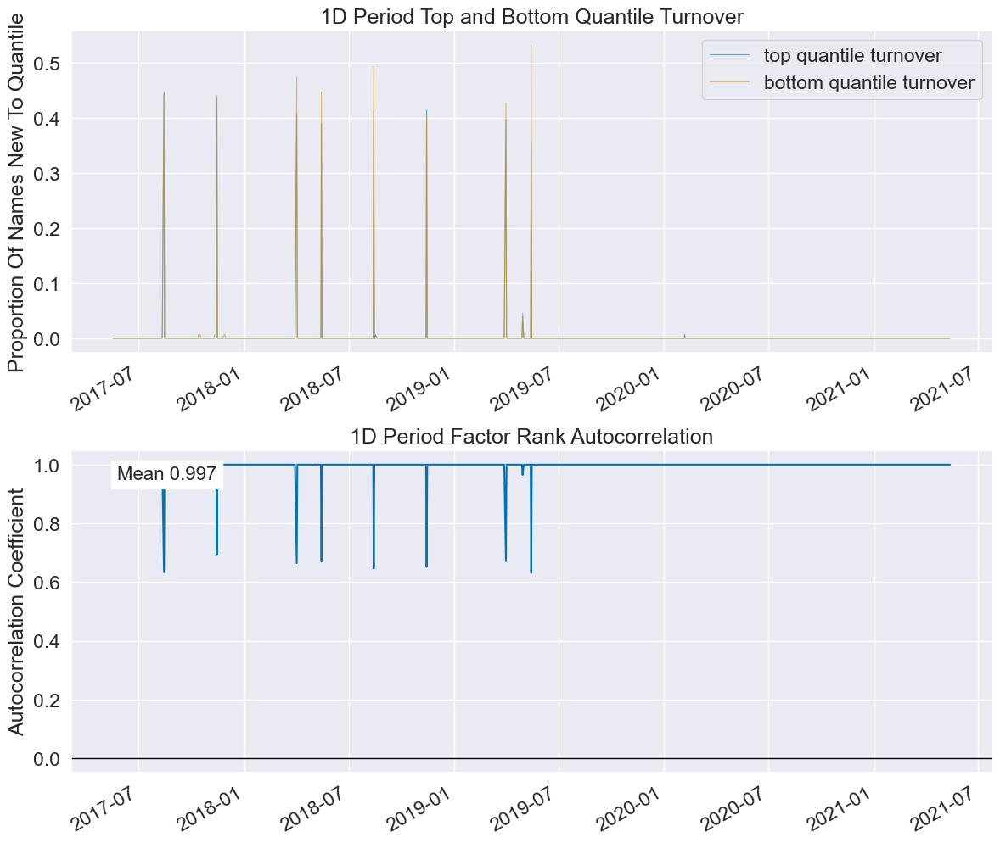

pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.501559,43.878579,147896,20.079424
2,153.0,304.0,228.004662,43.589160,146923,19.947322
3,304.0,455.0,379.005241,43.588837,146923,19.947322
4,455.0,606.0,530.006166,43.588579,146923,19.947322
5,606.0,757.0,681.503063,43.875465,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.019
beta,-0.017
Mean Period Wise Return Top Quantile (bps),0.922
Mean Period Wise Return Bottom Quantile (bps),-0.766
Mean Period Wise Spread (bps),1.688


<Figure size 640x480 with 0 Axes>

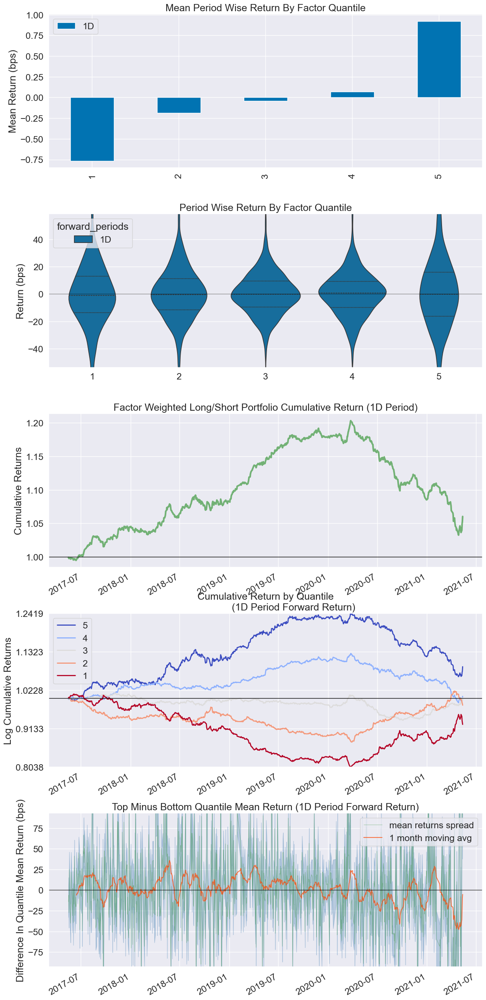

Information Analysis


,1D
IC Mean,0.020
IC Std.,0.078
Risk-Adjusted IC,0.250
t-stat(IC),7.810
p-value(IC),0.000
IC Skew,0.166
IC Kurtosis,0.247


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


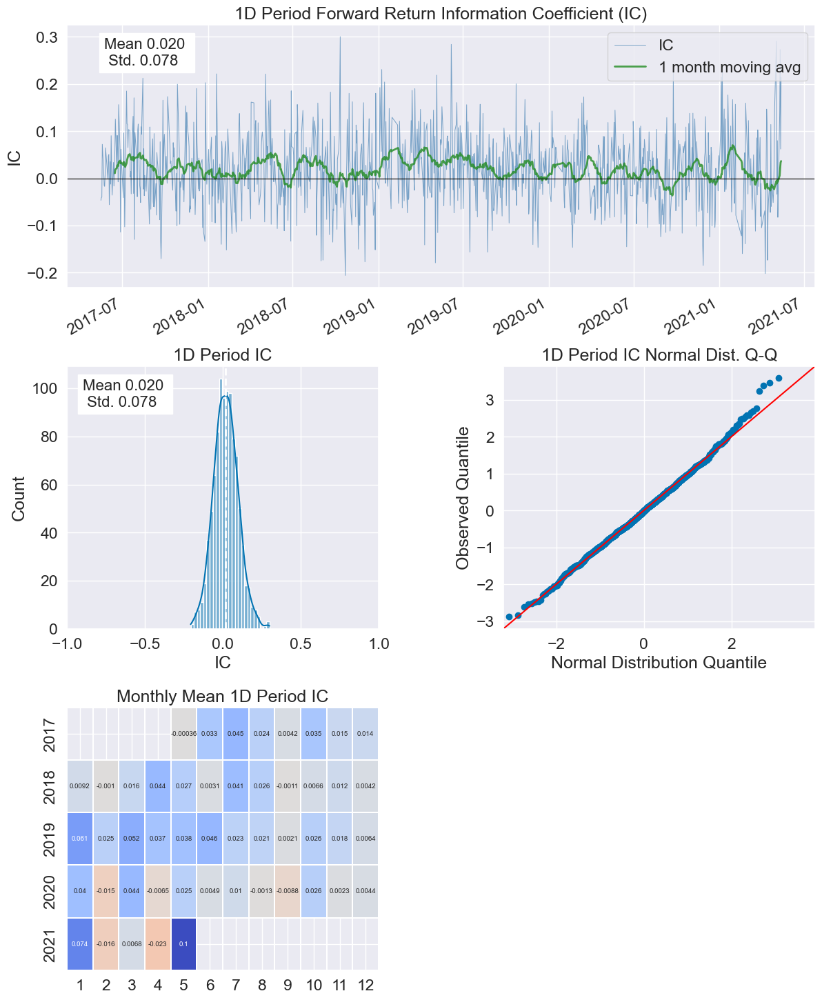

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.997


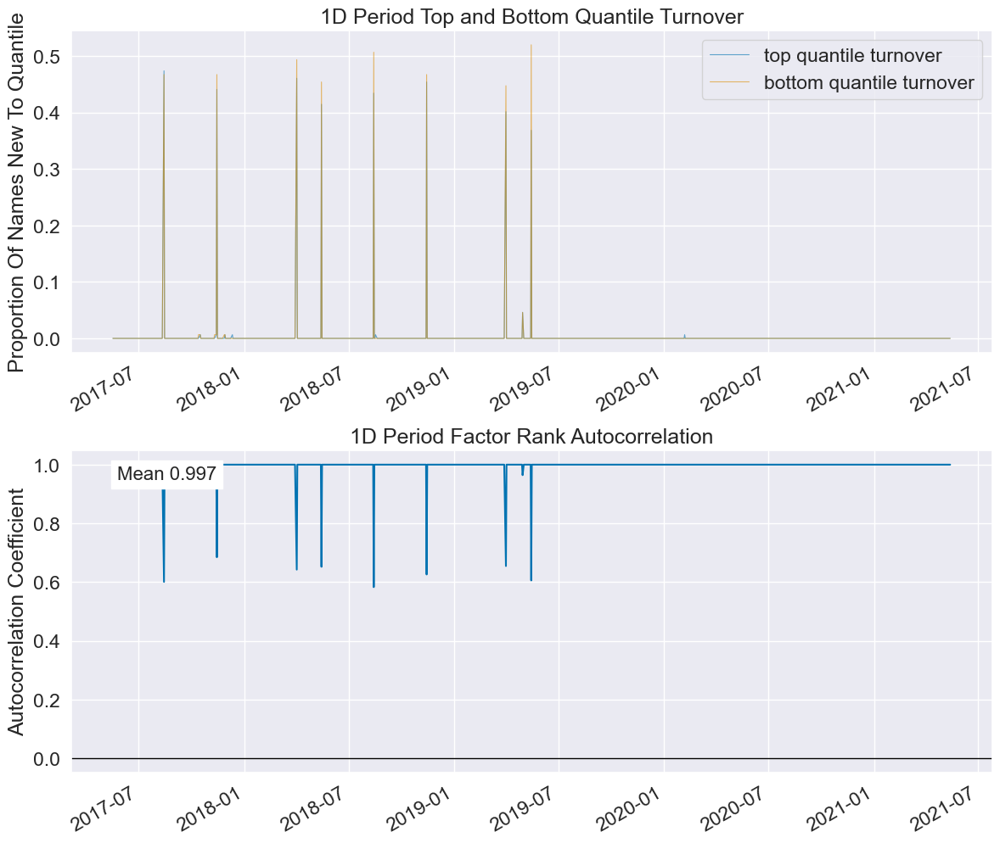

pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.501555,43.878658,147896,20.079424
2,153.0,304.5,228.037602,43.608803,146987,19.956011
3,304.0,455.5,379.071561,43.589917,146924,19.947458
4,455.0,606.5,530.091563,43.600322,146959,19.952210
5,606.0,757.0,681.554656,43.846164,147789,20.064897


Returns Analysis


,1D
Ann. alpha,0.018
beta,-0.018
Mean Period Wise Return Top Quantile (bps),0.987
Mean Period Wise Return Bottom Quantile (bps),-0.691
Mean Period Wise Spread (bps),1.678


<Figure size 640x480 with 0 Axes>

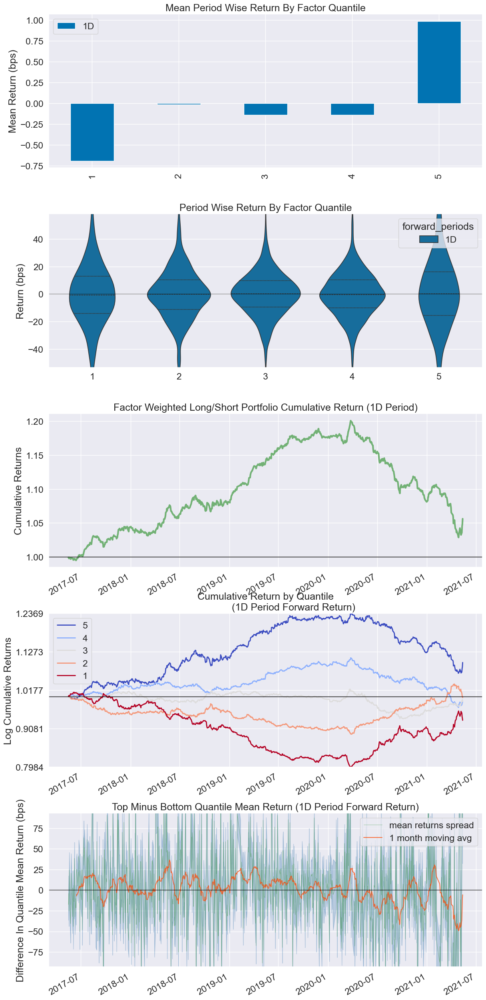

Information Analysis


,1D
IC Mean,0.020
IC Std.,0.079
Risk-Adjusted IC,0.250
t-stat(IC),7.791
p-value(IC),0.000
IC Skew,0.165
IC Kurtosis,0.259


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


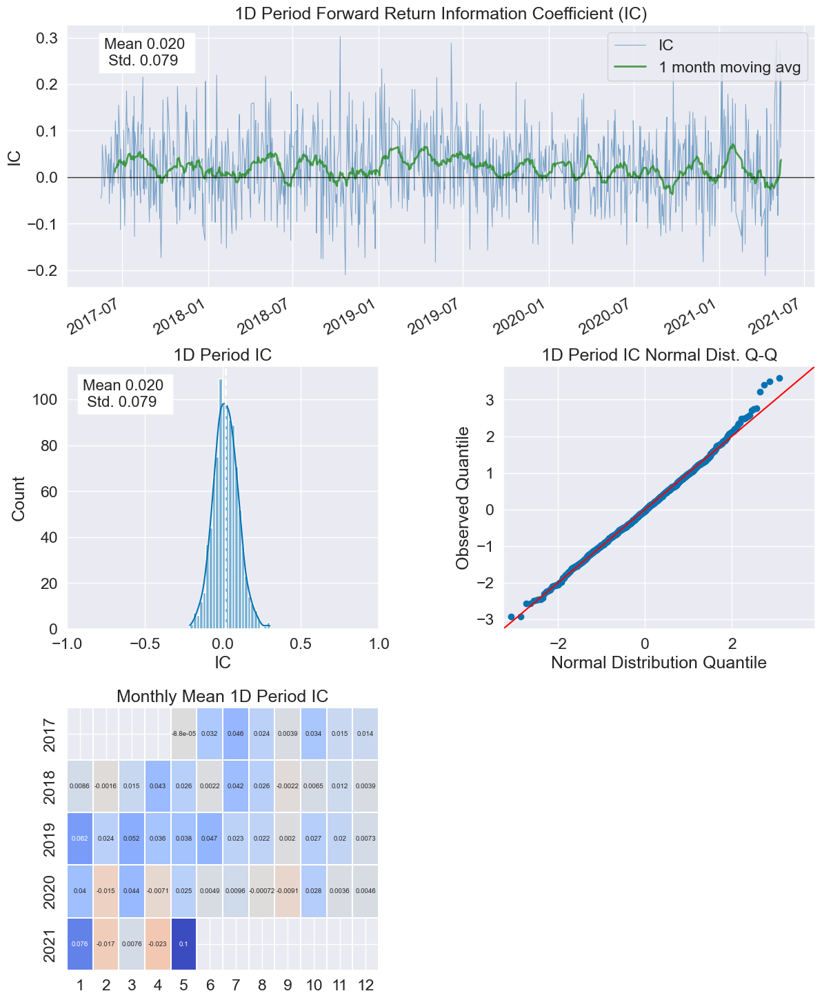

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.997


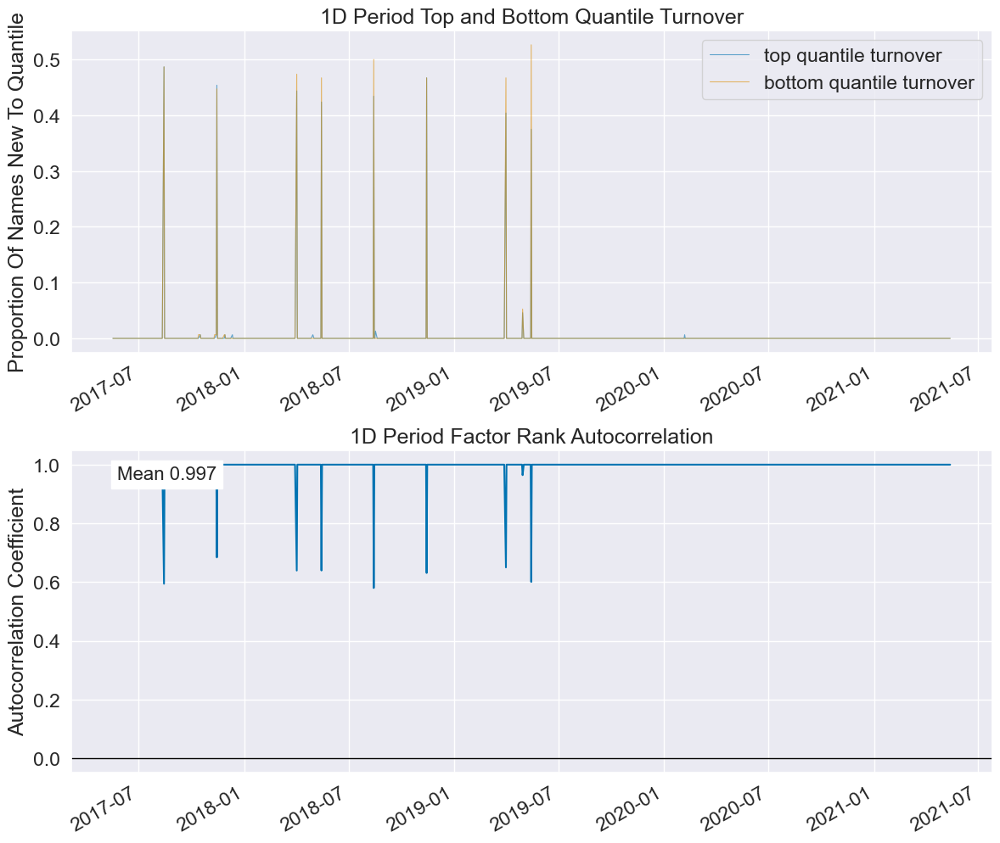

pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業利益成長率', '稅前淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.510557,43.883764,147915,20.082003
2,153.0,304.0,228.046854,43.602969,146967,19.953296
3,304.0,455.0,379.037648,43.570842,146860,19.938769
4,455.0,606.0,530.006166,43.588569,146923,19.947322
5,606.0,757.0,681.503063,43.875710,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.021
beta,-0.018
Mean Period Wise Return Top Quantile (bps),1.243
Mean Period Wise Return Bottom Quantile (bps),-0.830
Mean Period Wise Spread (bps),2.073


<Figure size 640x480 with 0 Axes>

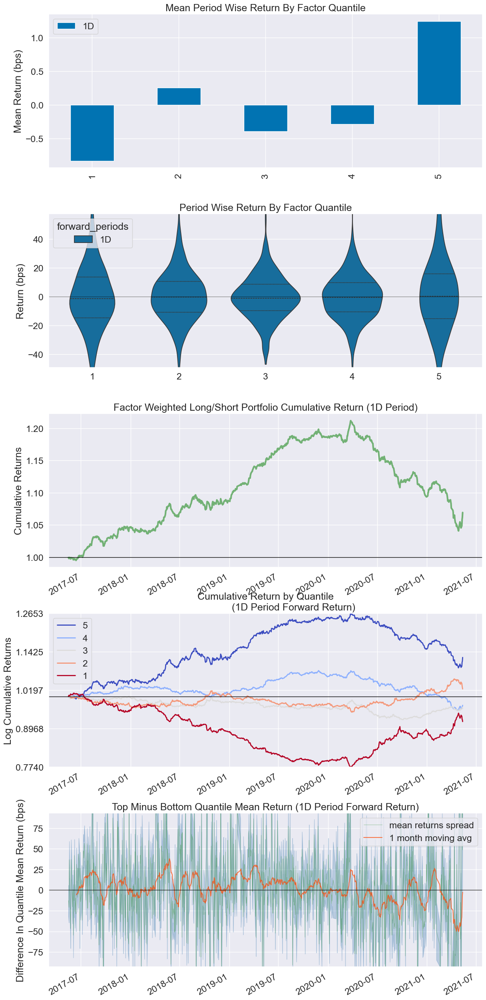

Information Analysis


,1D
IC Mean,0.019
IC Std.,0.077
Risk-Adjusted IC,0.251
t-stat(IC),7.830
p-value(IC),0.000
IC Skew,0.170
IC Kurtosis,0.233


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


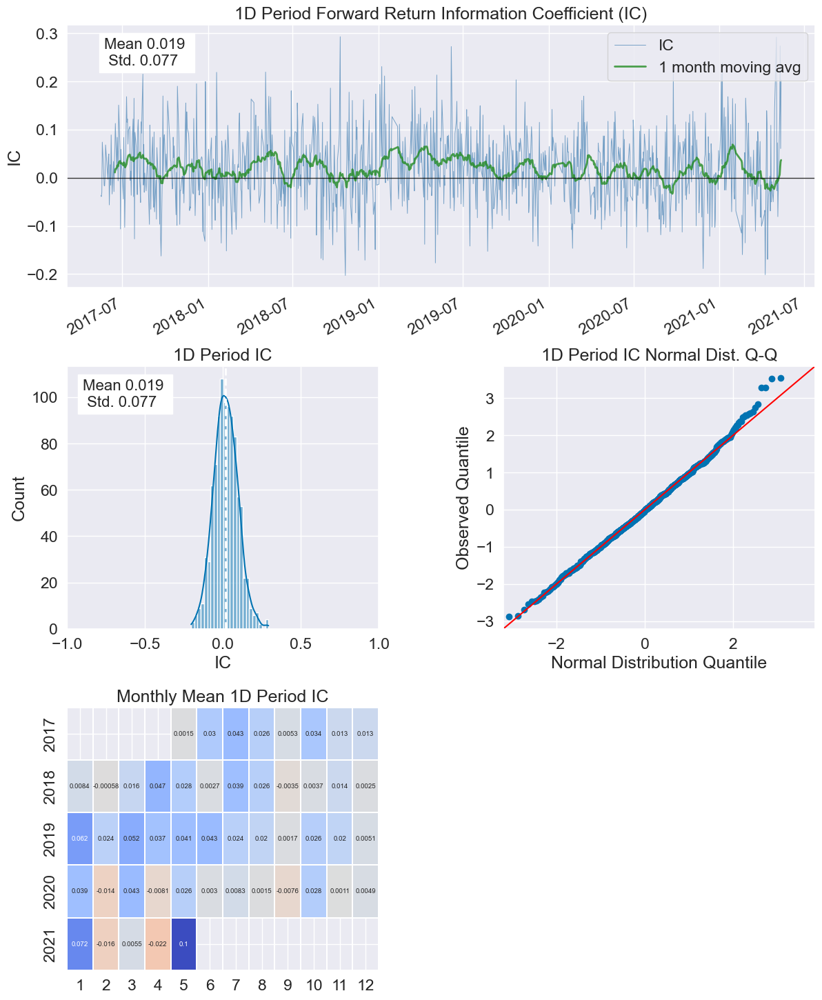

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.997


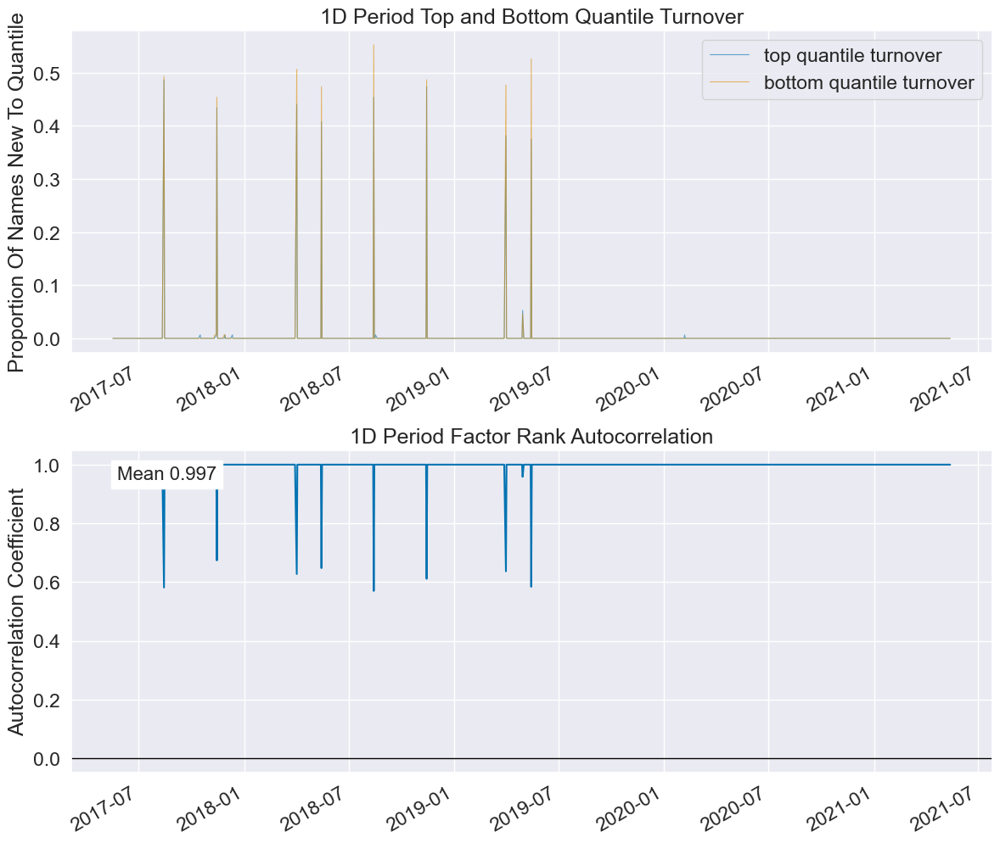

pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '營業利益成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500703,43.877990,147896,20.079424
2,153.0,304.0,228.004417,43.589725,146923,19.947322
3,304.0,455.0,379.046863,43.613320,147003,19.958184
4,455.0,607.0,530.049140,43.566653,146847,19.937004
5,606.0,757.0,681.505065,43.874501,147886,20.078066


Returns Analysis


,1D
Ann. alpha,0.020
beta,-0.018
Mean Period Wise Return Top Quantile (bps),1.223
Mean Period Wise Return Bottom Quantile (bps),-0.820
Mean Period Wise Spread (bps),2.043


<Figure size 640x480 with 0 Axes>

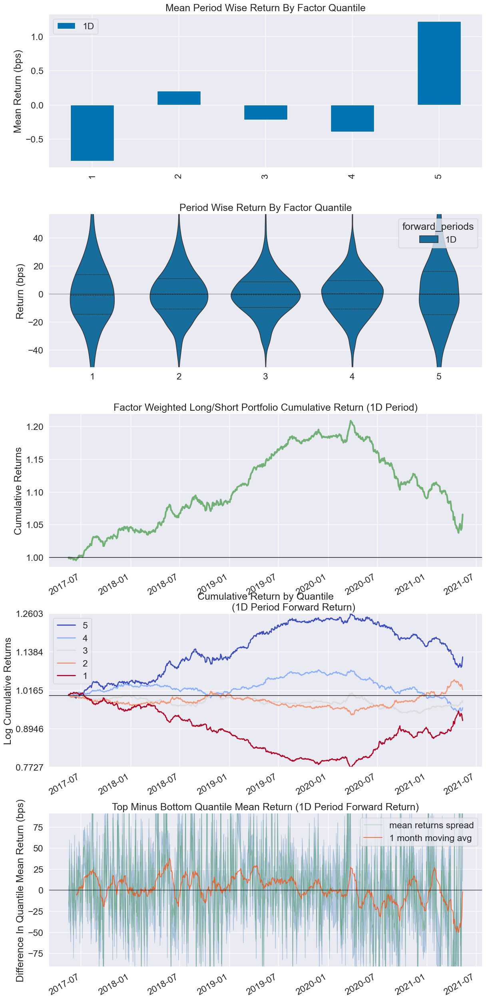

Information Analysis


,1D
IC Mean,0.020
IC Std.,0.078
Risk-Adjusted IC,0.251
t-stat(IC),7.818
p-value(IC),0.000
IC Skew,0.166
IC Kurtosis,0.239


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


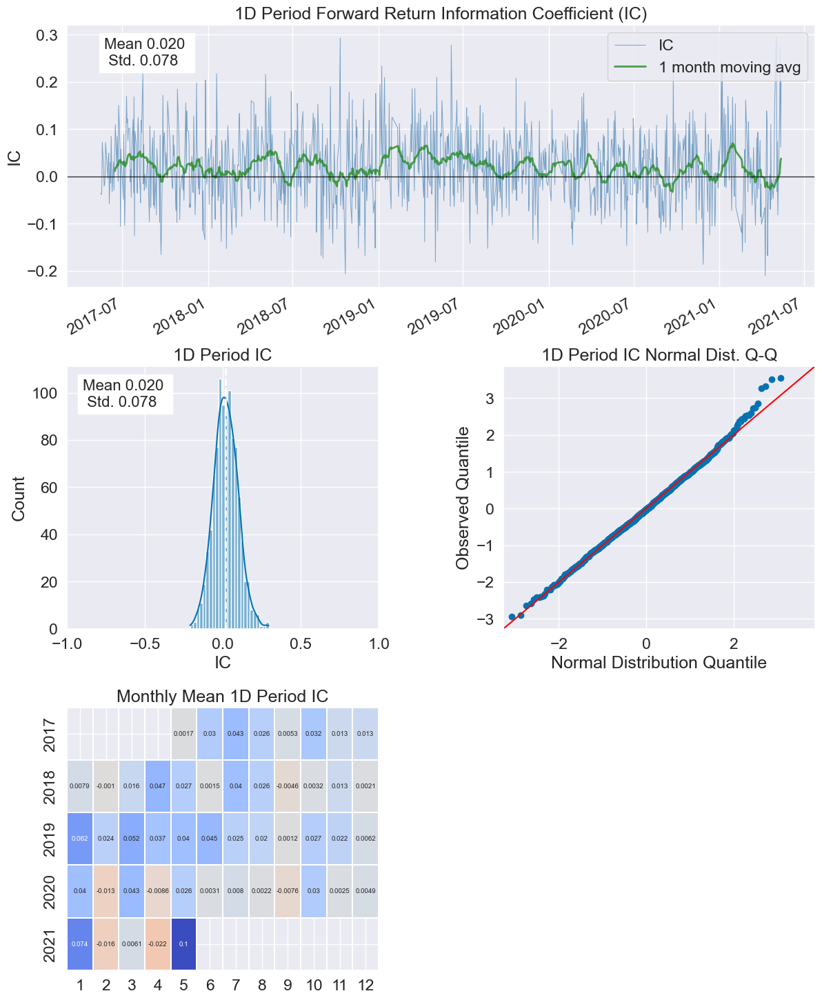

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.997


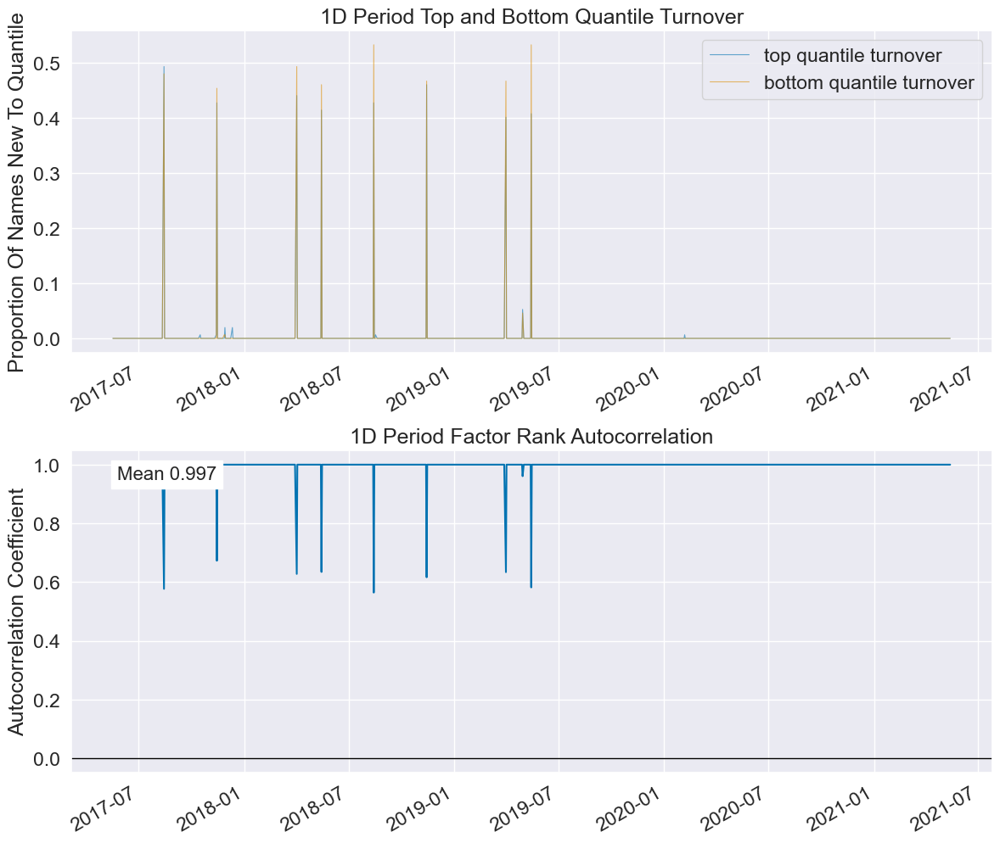

pair: ('營運現金流', '歸屬母公司淨利', 'ROE稅後', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500757,43.877962,147896,20.079424
2,153.0,304.0,228.036561,43.608999,146986,19.955876
3,304.0,455.0,379.047488,43.576451,146879,19.941349
4,455.0,606.0,530.034483,43.593953,146940,19.949630
5,606.0,757.0,681.521447,43.865025,147854,20.073722


Returns Analysis


,1D
Ann. alpha,0.021
beta,-0.014
Mean Period Wise Return Top Quantile (bps),1.115
Mean Period Wise Return Bottom Quantile (bps),-0.703
Mean Period Wise Spread (bps),1.818


<Figure size 640x480 with 0 Axes>

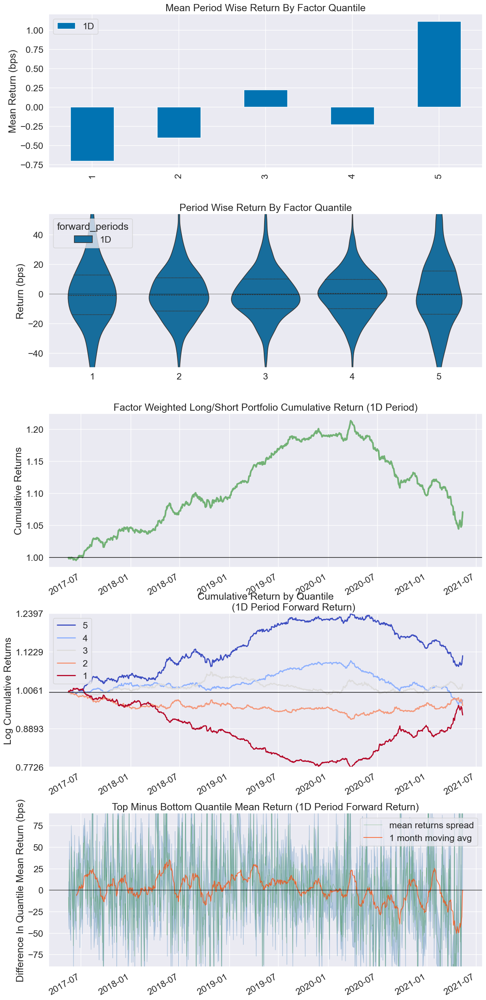

Information Analysis


,1D
IC Mean,0.019
IC Std.,0.076
Risk-Adjusted IC,0.250
t-stat(IC),7.797
p-value(IC),0.000
IC Skew,0.171
IC Kurtosis,0.254


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


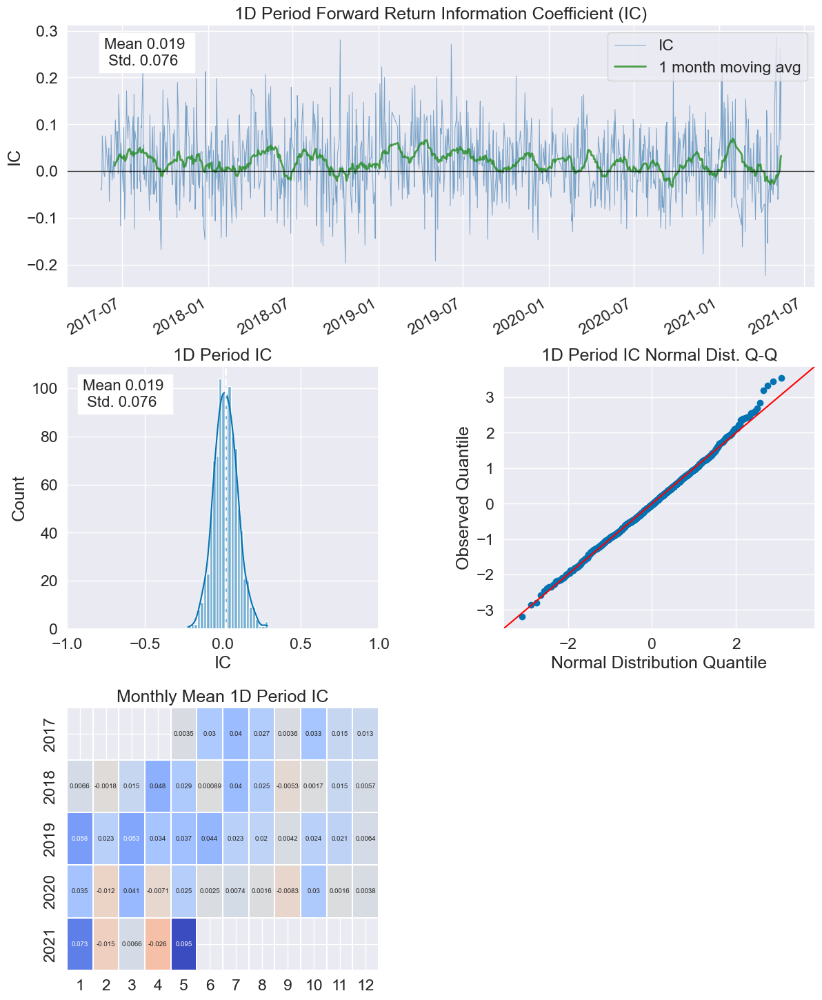

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


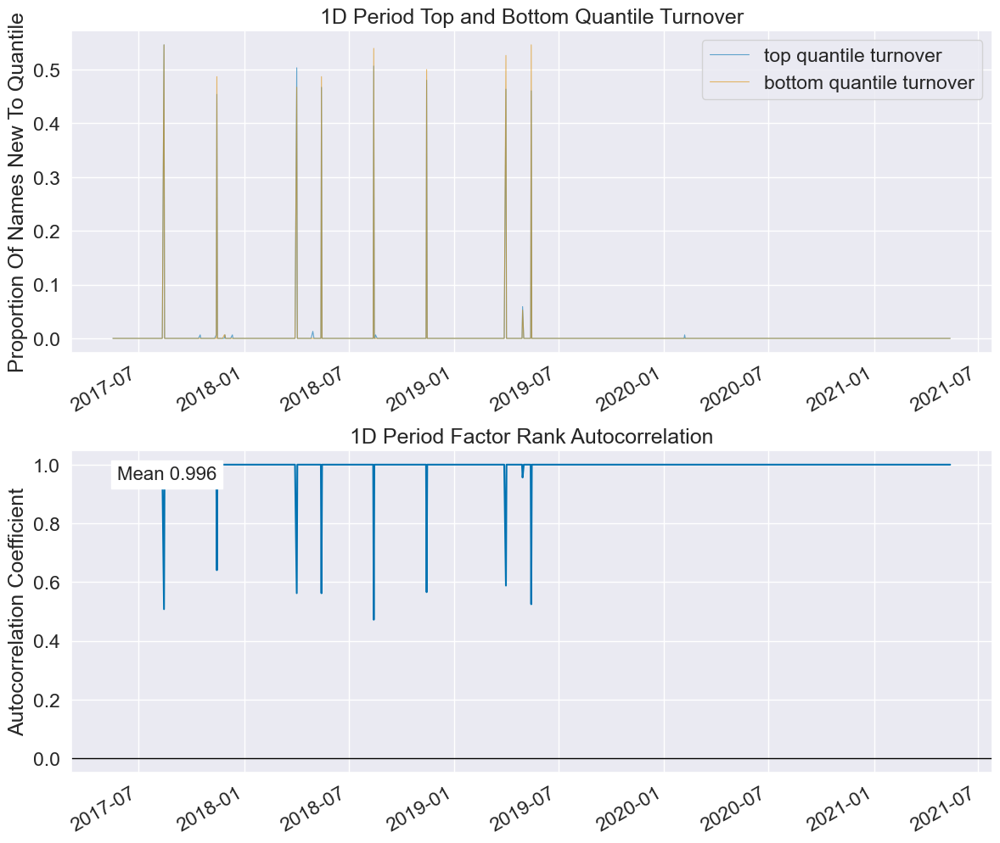

pair: ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.533992,43.897525,147960,20.088113
2,153.0,304.0,228.286567,43.715612,147344,20.004480
3,304.0,455.0,379.263306,43.451977,146457,19.884055
4,455.0,606.0,530.015602,43.583373,146904,19.944743
5,606.0,757.0,681.503063,43.875460,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.027
beta,-0.000
Mean Period Wise Return Top Quantile (bps),2.192
Mean Period Wise Return Bottom Quantile (bps),-1.181
Mean Period Wise Spread (bps),3.373


<Figure size 640x480 with 0 Axes>

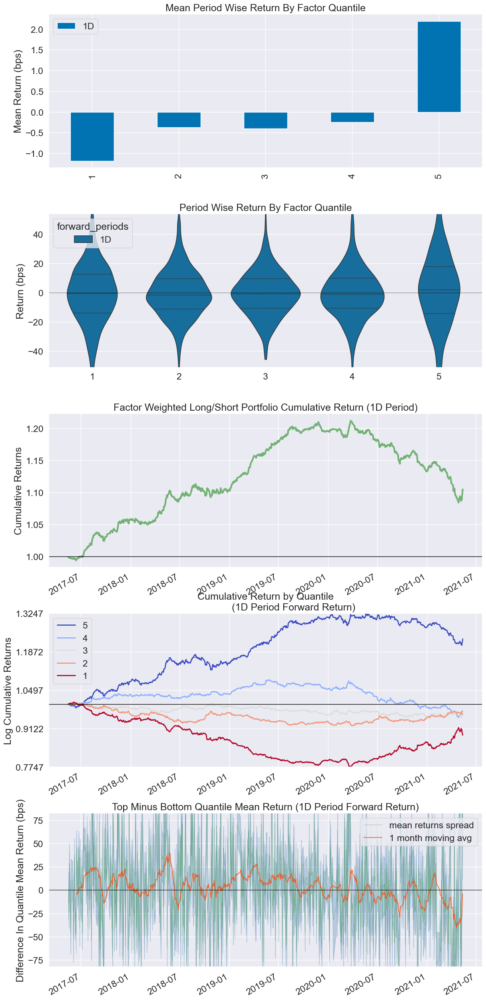

Information Analysis


,1D
IC Mean,0.014
IC Std.,0.069
Risk-Adjusted IC,0.207
t-stat(IC),6.463
p-value(IC),0.000
IC Skew,0.195
IC Kurtosis,0.302


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


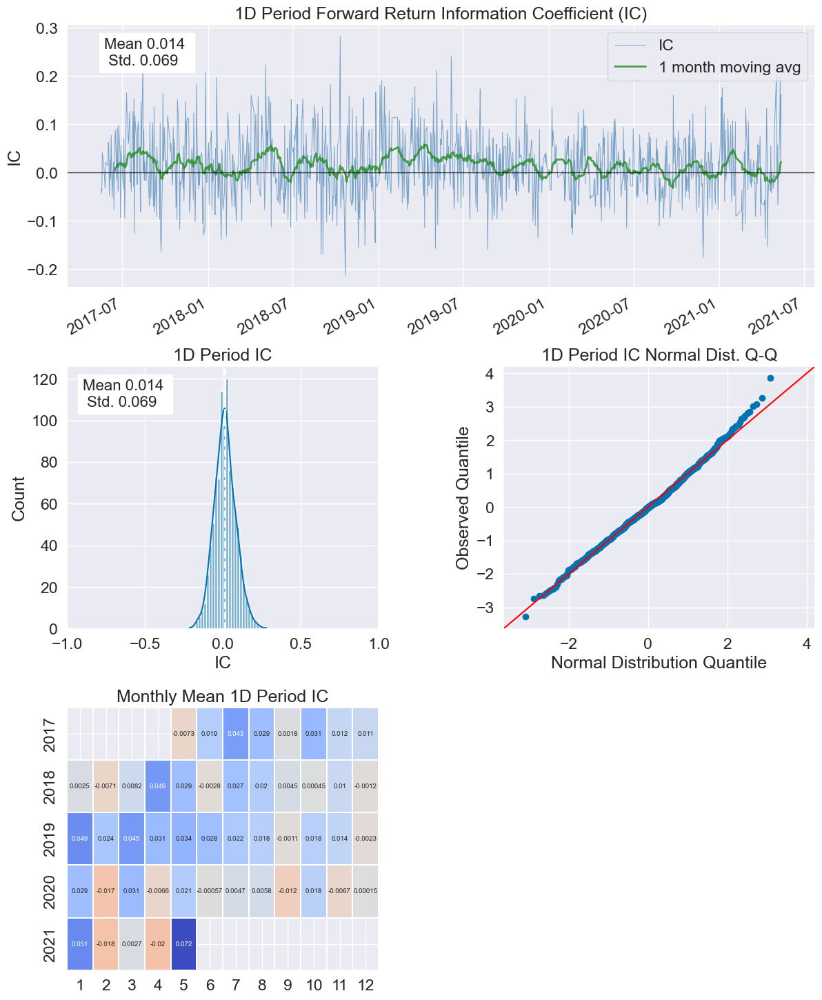

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


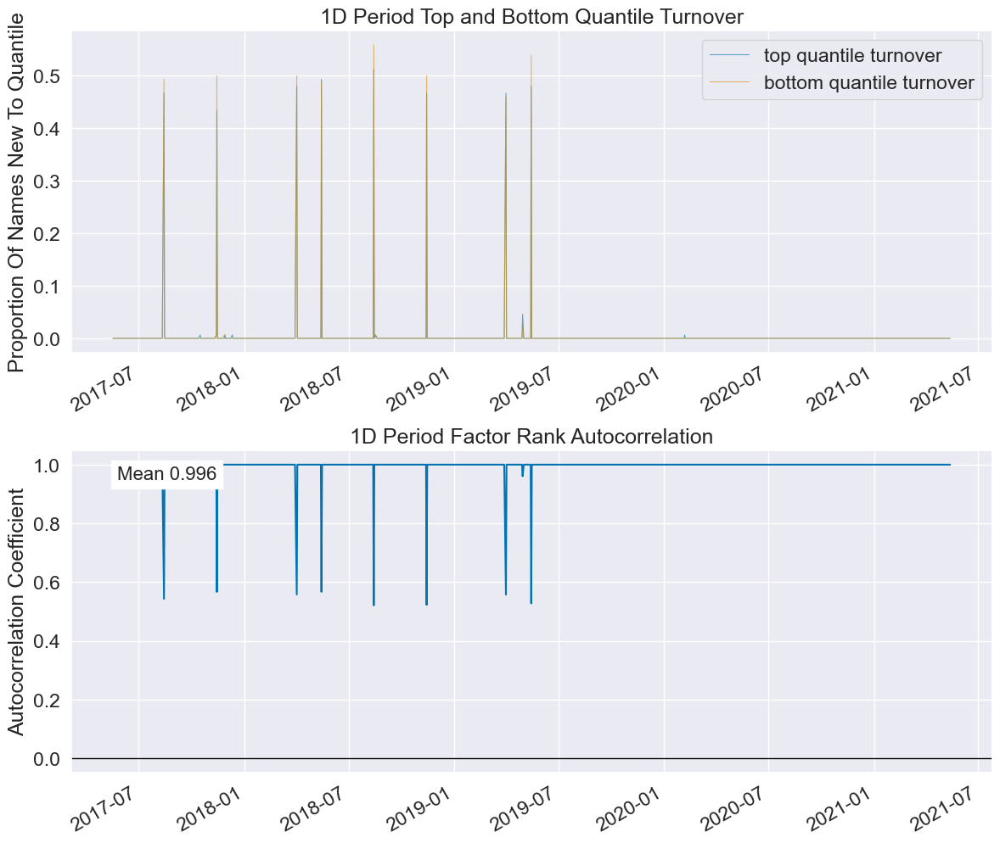

pair: ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.750912,44.023421,148381,20.145271
2,153.0,304.5,228.285851,43.466278,146503,19.890300
3,304.0,455.0,379.043331,43.573066,146868,19.939855
4,455.0,606.0,530.043633,43.605019,146976,19.954518
5,606.0,757.0,681.535241,43.857237,147827,20.070056


Returns Analysis


,1D
Ann. alpha,0.026
beta,-0.001
Mean Period Wise Return Top Quantile (bps),2.127
Mean Period Wise Return Bottom Quantile (bps),-1.073
Mean Period Wise Spread (bps),3.200


<Figure size 640x480 with 0 Axes>

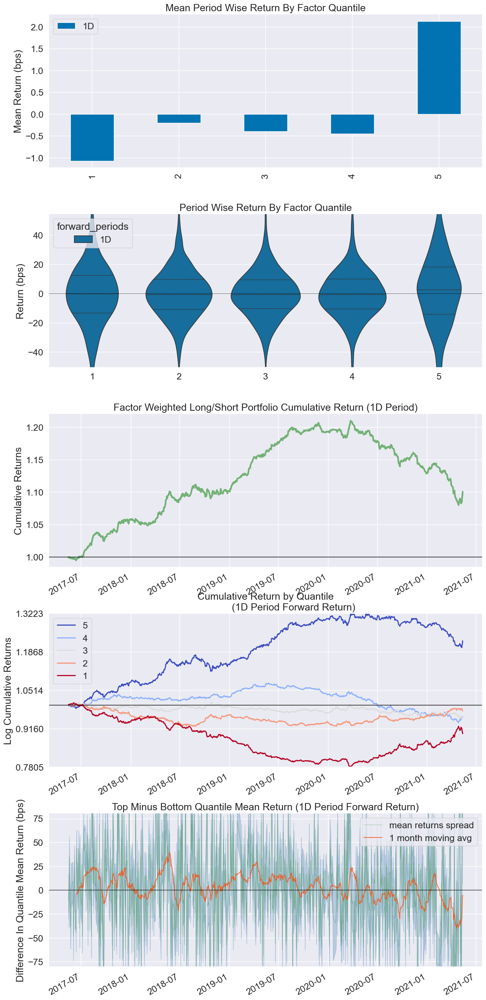

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.070
Risk-Adjusted IC,0.208
t-stat(IC),6.499
p-value(IC),0.000
IC Skew,0.193
IC Kurtosis,0.297


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


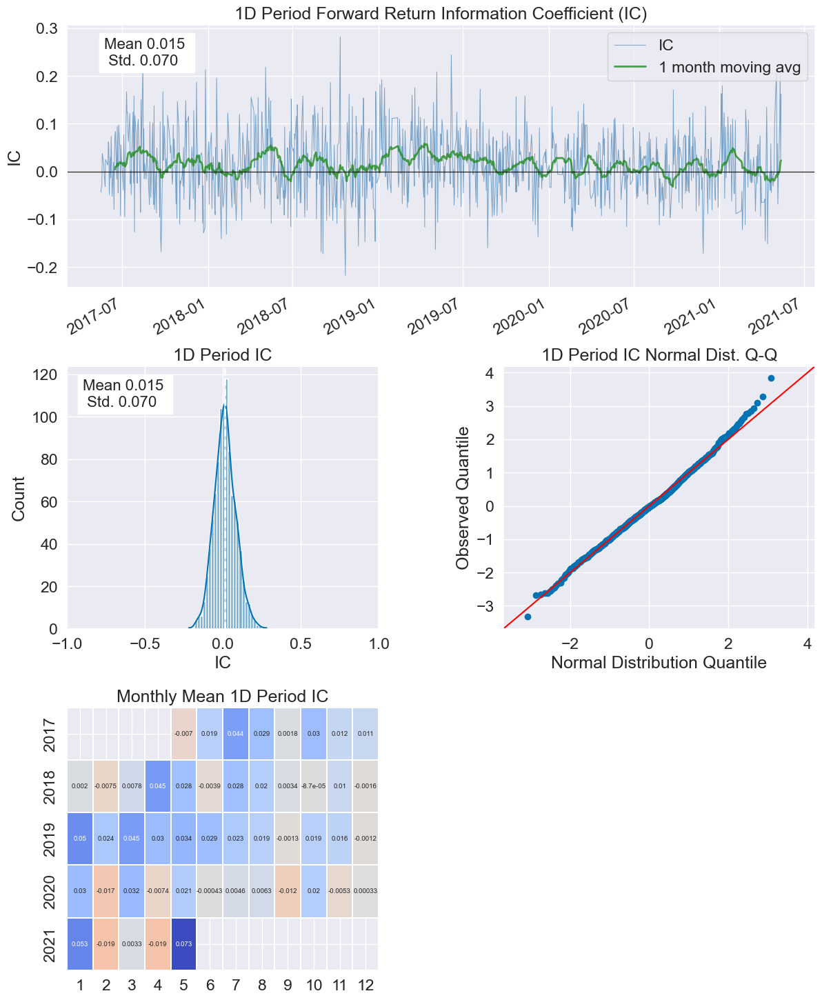

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


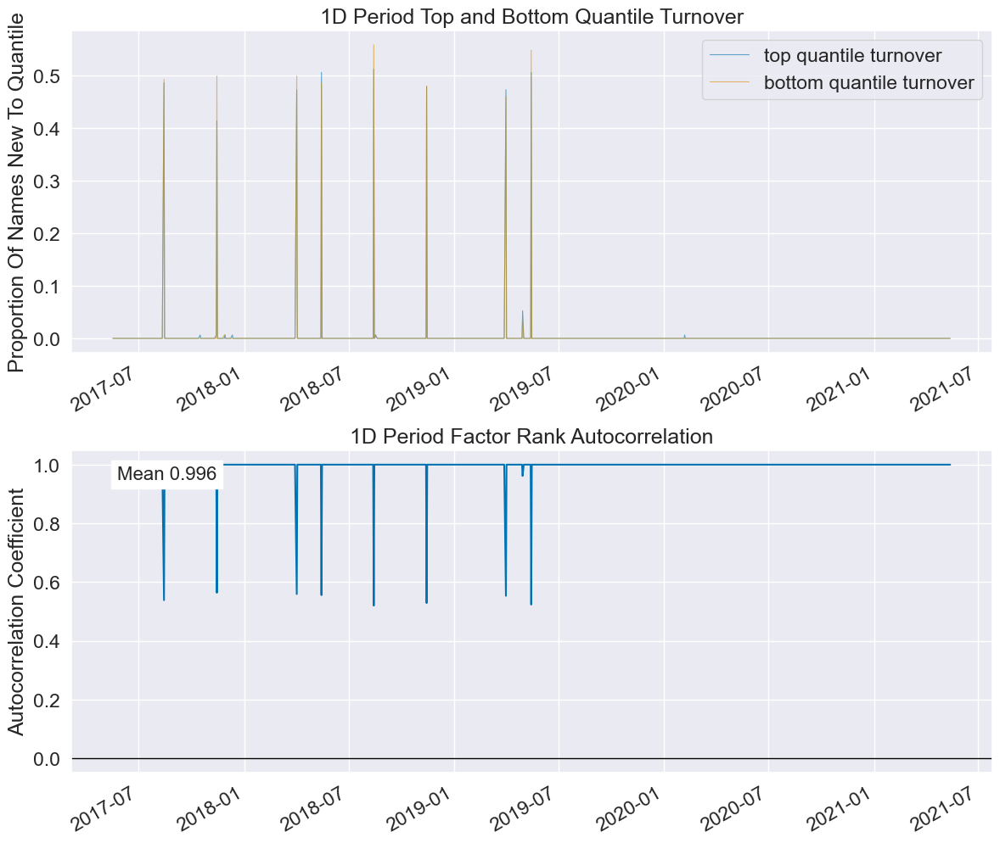

pair: ('營運現金流', '歸屬母公司淨利', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500818,43.877755,147896,20.079424
2,153.0,304.0,228.003485,43.589777,146923,19.947322
3,304.0,455.0,379.036677,43.606957,146984,19.955604
4,455.0,606.5,530.115071,43.616638,147013,19.959541
5,606.0,757.0,681.580226,43.831505,147739,20.058108


Returns Analysis


,1D
Ann. alpha,0.026
beta,0.003
Mean Period Wise Return Top Quantile (bps),1.883
Mean Period Wise Return Bottom Quantile (bps),-1.144
Mean Period Wise Spread (bps),3.027


<Figure size 640x480 with 0 Axes>

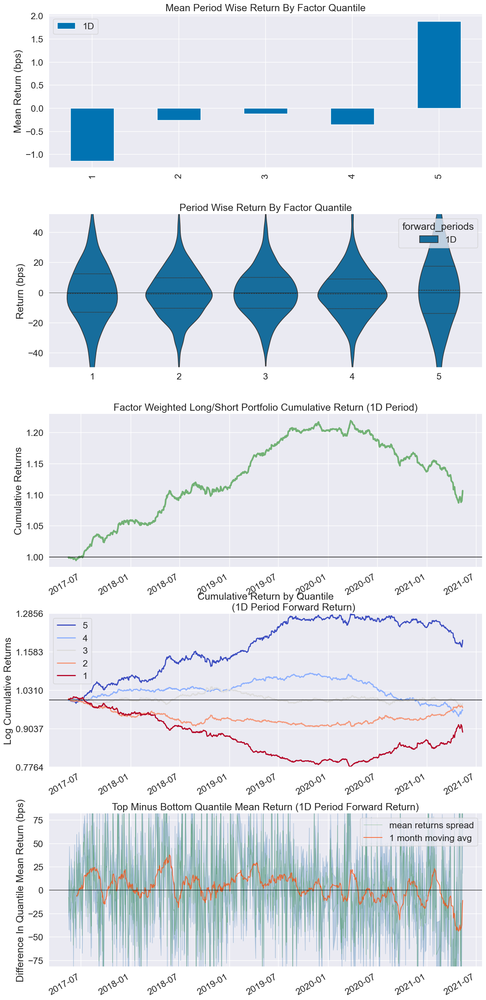

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.069
Risk-Adjusted IC,0.210
t-stat(IC),6.542
p-value(IC),0.000
IC Skew,0.204
IC Kurtosis,0.348


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


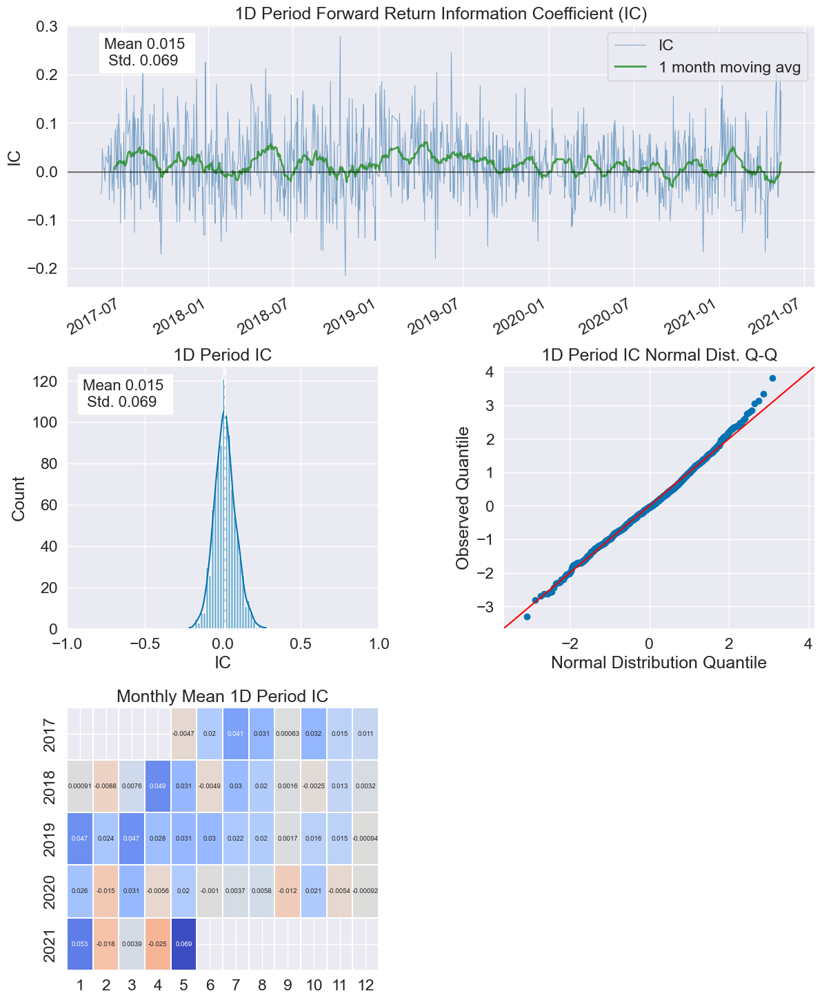

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


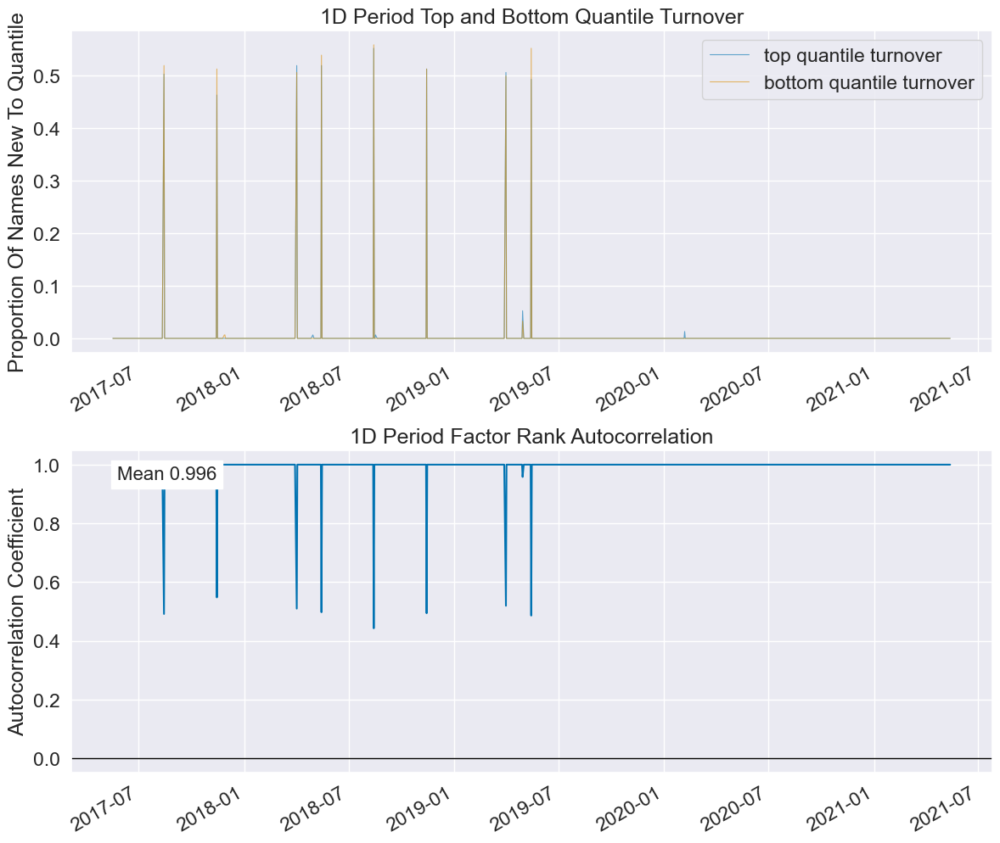

pair: ('營運現金流', '歸屬母公司淨利', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.545583,43.904361,147983,20.091236
2,153.0,305.0,228.047913,43.564441,146838,19.935782
3,304.0,455.0,379.005996,43.588110,146921,19.947051
4,455.0,606.5,530.006684,43.589035,146924,19.947458
5,606.0,757.0,681.503567,43.875399,147889,20.078473


Returns Analysis


,1D
Ann. alpha,0.029
beta,0.002
Mean Period Wise Return Top Quantile (bps),2.015
Mean Period Wise Return Bottom Quantile (bps),-1.074
Mean Period Wise Spread (bps),3.089


<Figure size 640x480 with 0 Axes>

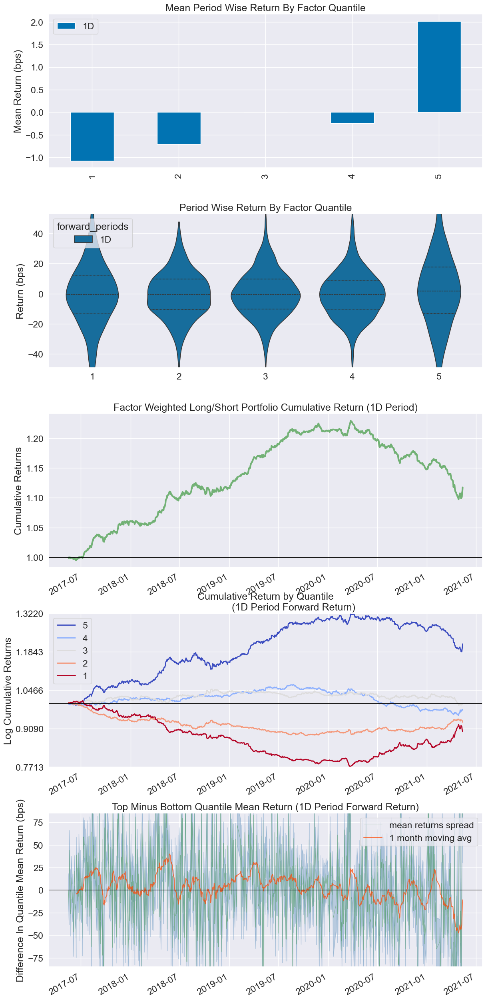

Information Analysis


,1D
IC Mean,0.014
IC Std.,0.068
Risk-Adjusted IC,0.210
t-stat(IC),6.565
p-value(IC),0.000
IC Skew,0.200
IC Kurtosis,0.322


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


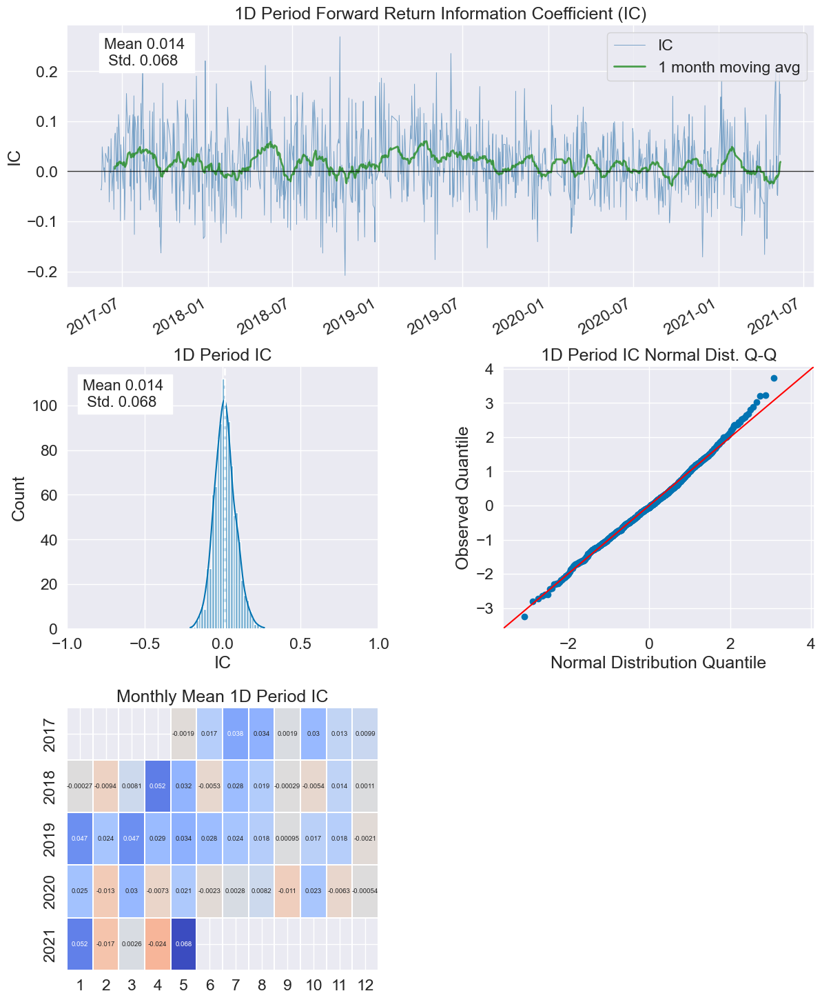

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


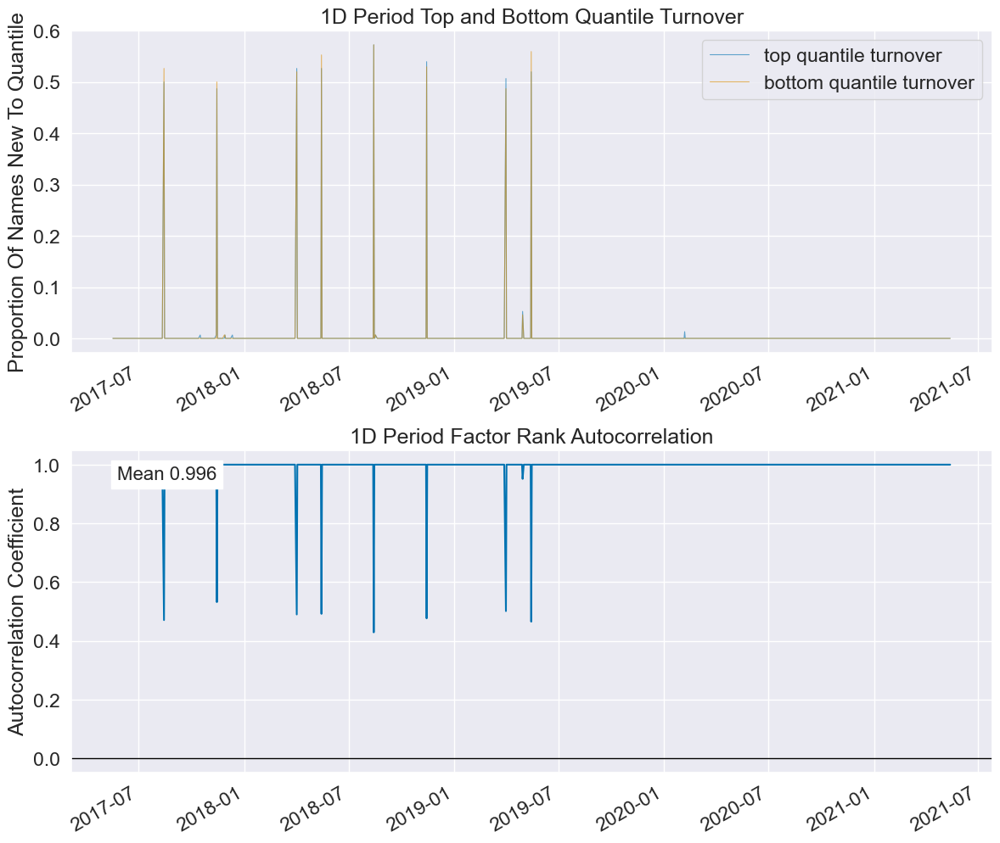

pair: ('營運現金流', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500805,43.877932,147896,20.079424
2,153.0,304.5,228.004911,43.589786,146925,19.947594
3,304.0,455.0,379.092770,43.638940,147089,19.969860
4,455.0,606.5,530.124344,43.559346,146819,19.933203
5,606.0,757.0,681.535745,43.857009,147826,20.069920


Returns Analysis


,1D
Ann. alpha,0.029
beta,-0.002
Mean Period Wise Return Top Quantile (bps),2.137
Mean Period Wise Return Bottom Quantile (bps),-1.182
Mean Period Wise Spread (bps),3.318


<Figure size 640x480 with 0 Axes>

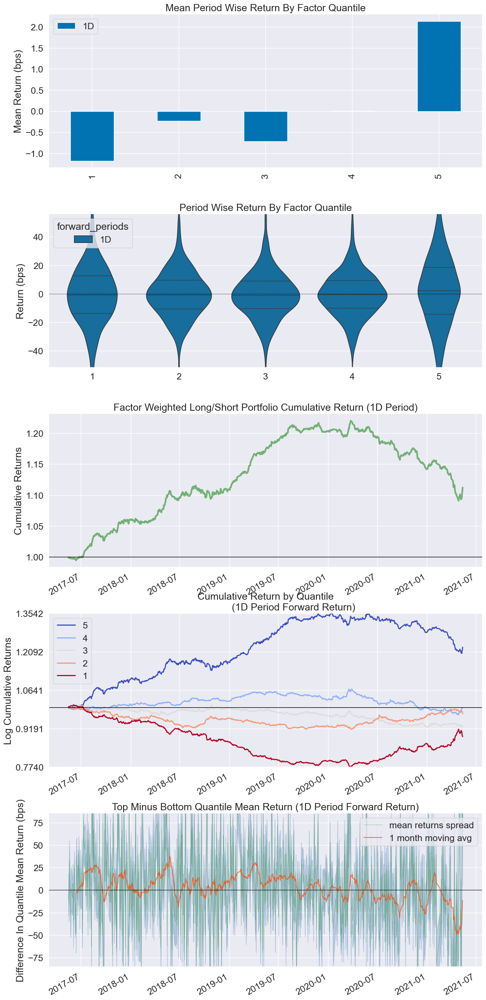

Information Analysis


,1D
IC Mean,0.013
IC Std.,0.067
Risk-Adjusted IC,0.194
t-stat(IC),6.046
p-value(IC),0.000
IC Skew,0.230
IC Kurtosis,0.356


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


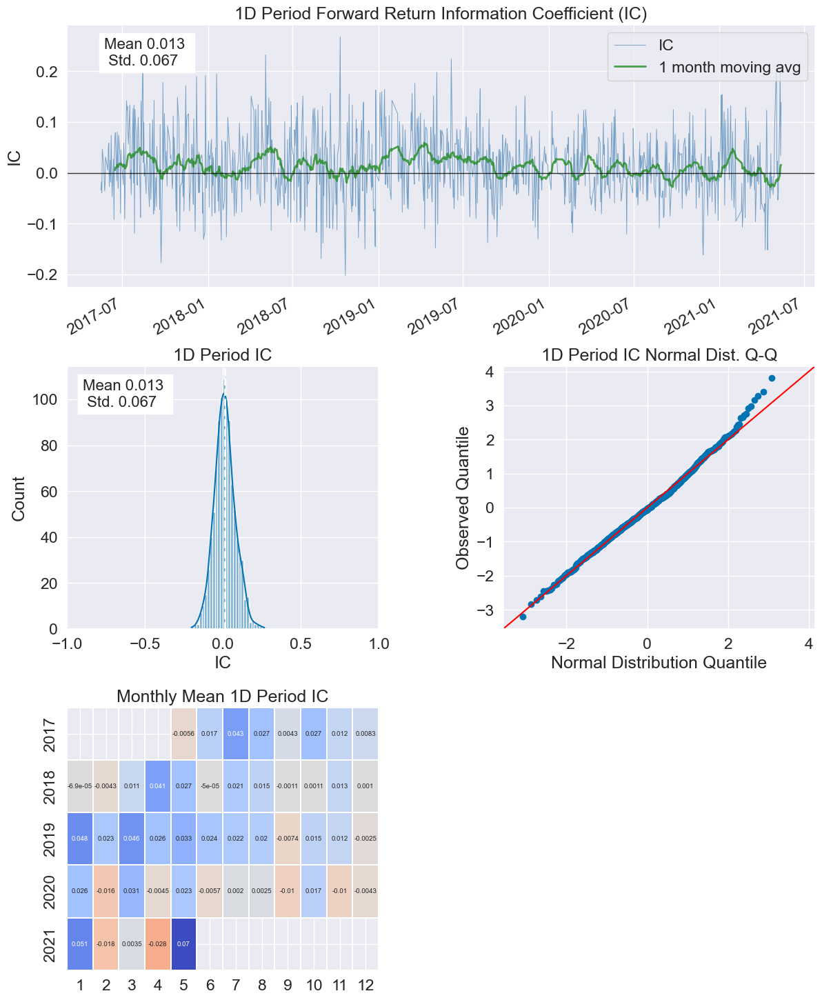

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


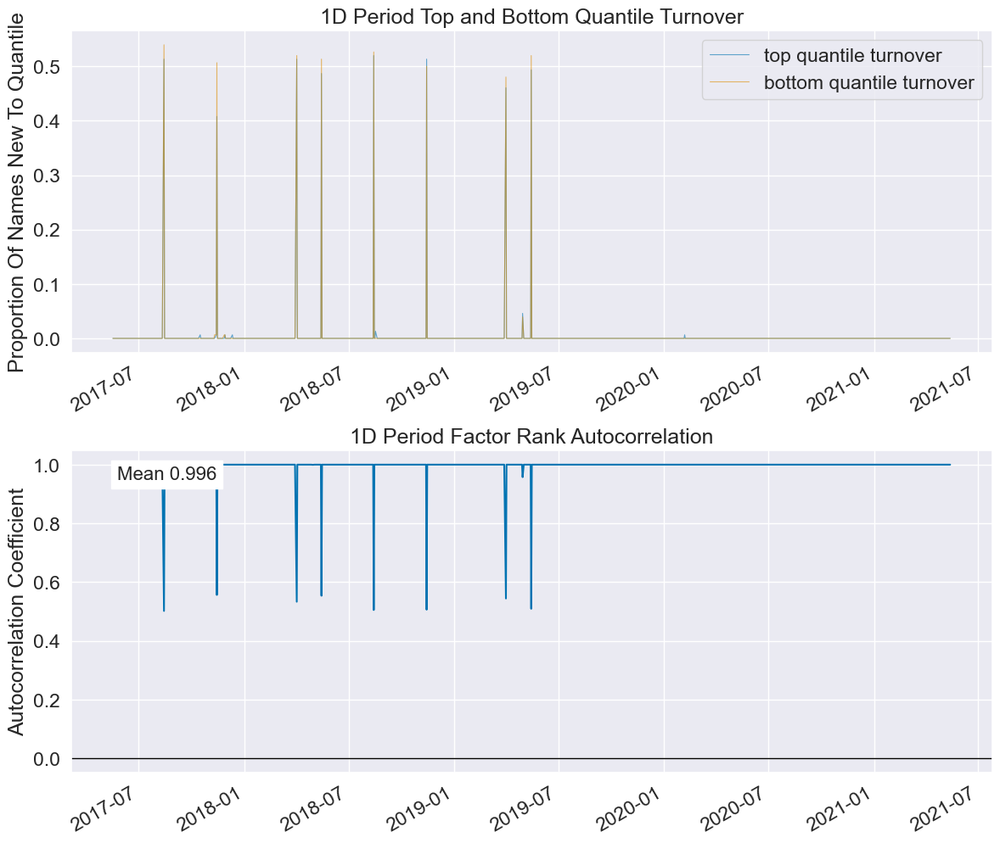

pair: ('營運現金流', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.532871,43.896676,147958,20.087841
2,153.0,304.0,228.076806,43.595385,146941,19.949766
3,304.0,455.0,379.082443,43.587151,146914,19.946100
4,455.0,606.0,530.074199,43.587397,146915,19.946236
5,606.0,757.0,681.535241,43.857350,147827,20.070056


Returns Analysis


,1D
Ann. alpha,0.028
beta,-0.003
Mean Period Wise Return Top Quantile (bps),2.143
Mean Period Wise Return Bottom Quantile (bps),-1.043
Mean Period Wise Spread (bps),3.186


<Figure size 640x480 with 0 Axes>

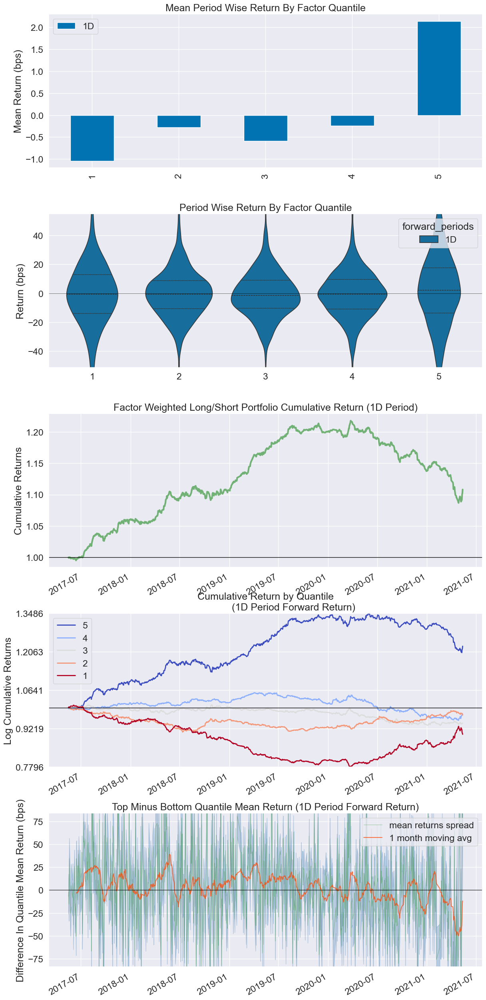

Information Analysis


,1D
IC Mean,0.013
IC Std.,0.068
Risk-Adjusted IC,0.195
t-stat(IC),6.087
p-value(IC),0.000
IC Skew,0.224
IC Kurtosis,0.349


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


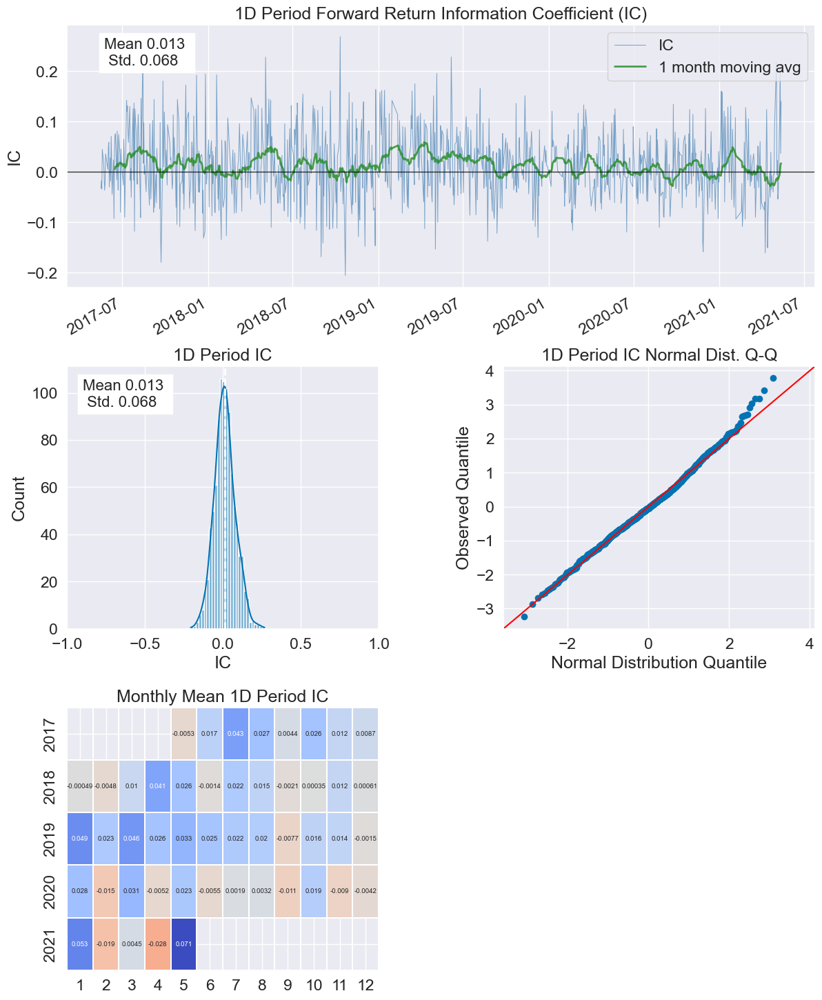

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


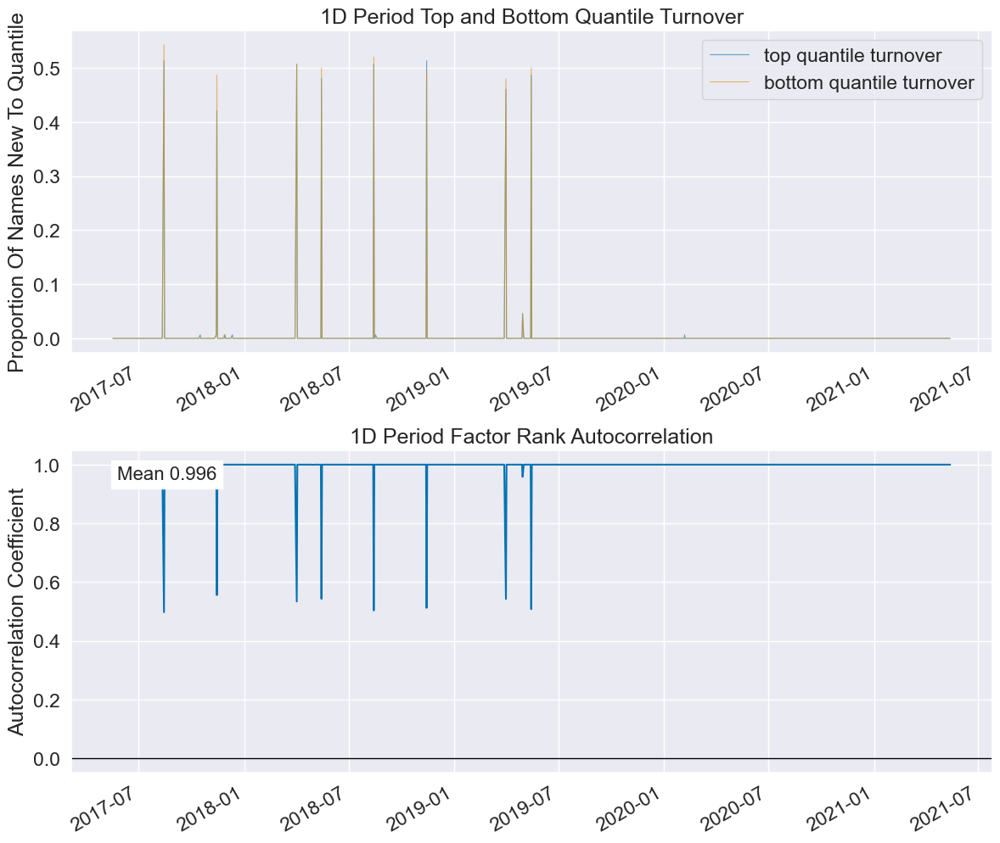

pair: ('營運現金流', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.750891,44.023112,148381,20.145271
2,153.0,304.0,228.260524,43.452740,146455,19.883783
3,304.0,455.5,379.014866,43.584257,146908,19.945286
4,455.0,606.0,530.038882,43.607485,146984,19.955604
5,606.0,757.0,681.535241,43.857145,147827,20.070056


Returns Analysis


,1D
Ann. alpha,0.028
beta,0.001
Mean Period Wise Return Top Quantile (bps),1.990
Mean Period Wise Return Bottom Quantile (bps),-1.115
Mean Period Wise Spread (bps),3.105


<Figure size 640x480 with 0 Axes>

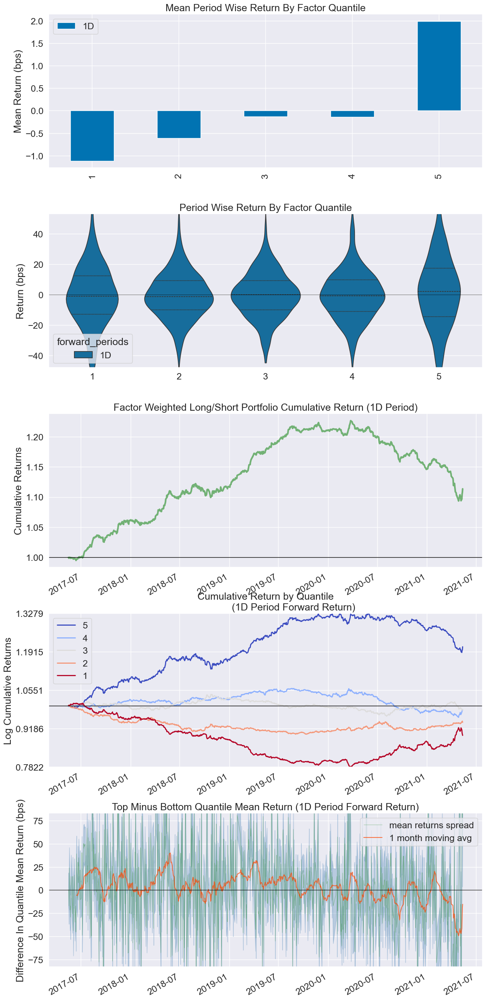

Information Analysis


,1D
IC Mean,0.013
IC Std.,0.067
Risk-Adjusted IC,0.196
t-stat(IC),6.103
p-value(IC),0.000
IC Skew,0.222
IC Kurtosis,0.384


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


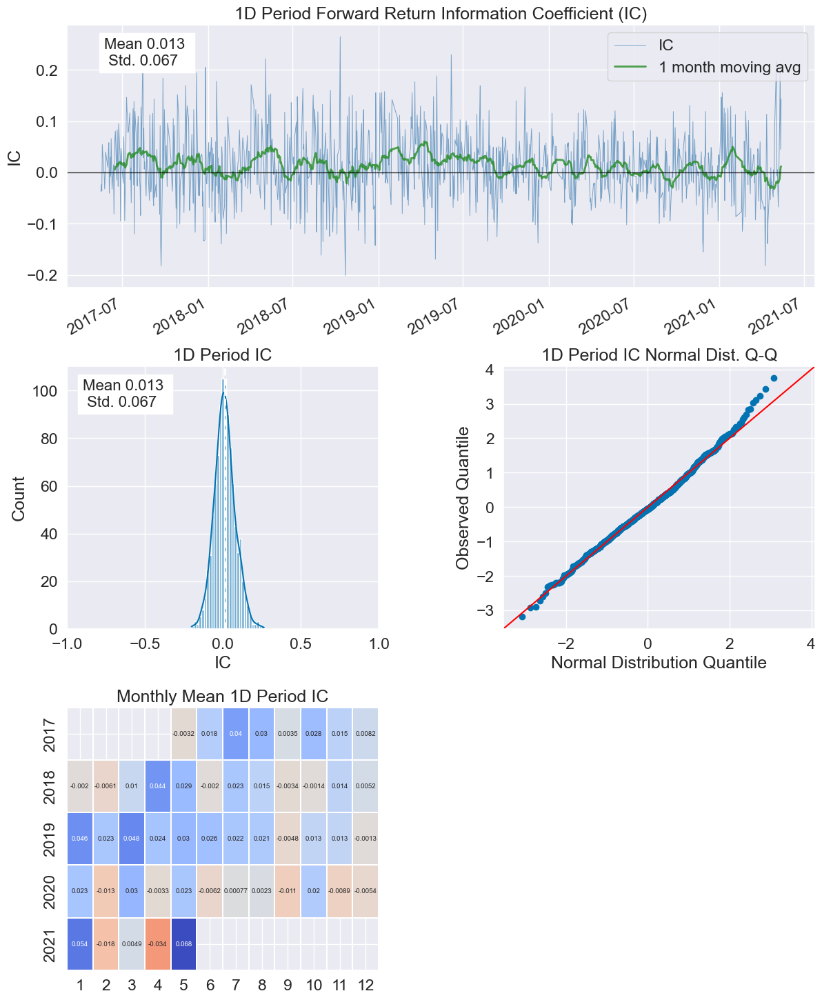

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


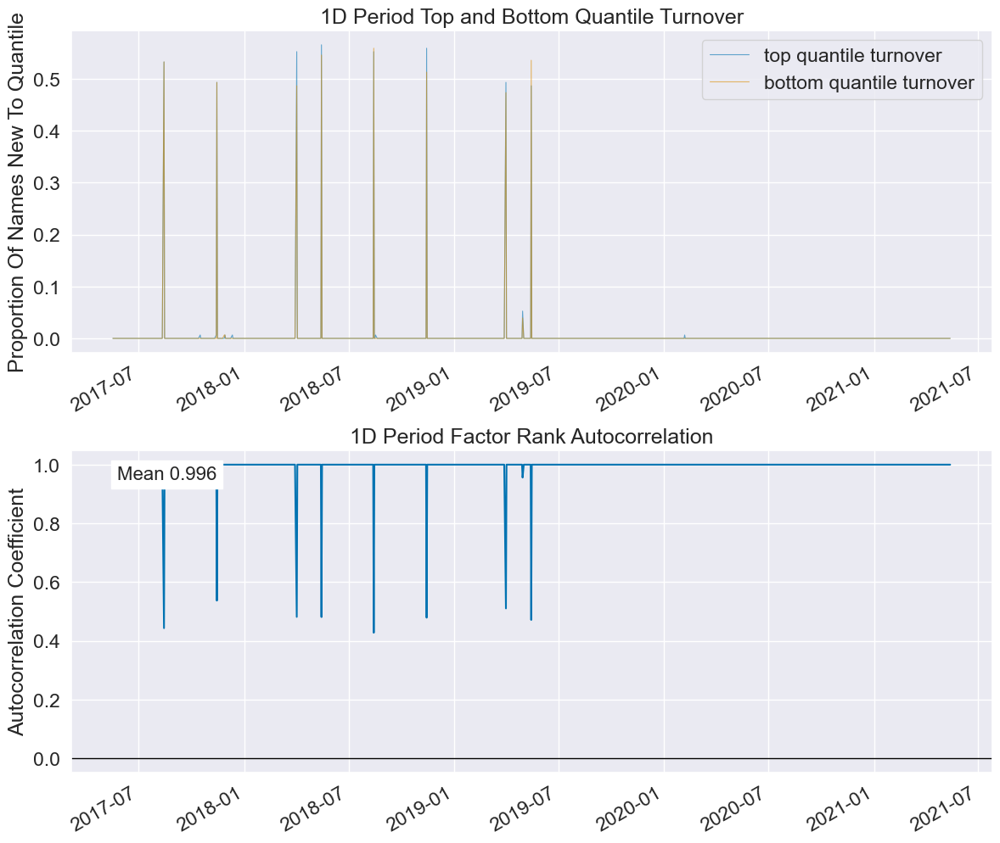

pair: ('營運現金流', 'ROE稅後', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500622,43.877960,147896,20.079424
2,153.0,304.0,228.080439,43.635323,147074,19.967823
3,304.0,455.0,379.082305,43.544428,146772,19.926821
4,455.0,606.0,530.005493,43.589082,146923,19.947322
5,606.0,757.0,681.503063,43.875585,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.031
beta,0.000
Mean Period Wise Return Top Quantile (bps),2.215
Mean Period Wise Return Bottom Quantile (bps),-1.095
Mean Period Wise Spread (bps),3.310


<Figure size 640x480 with 0 Axes>

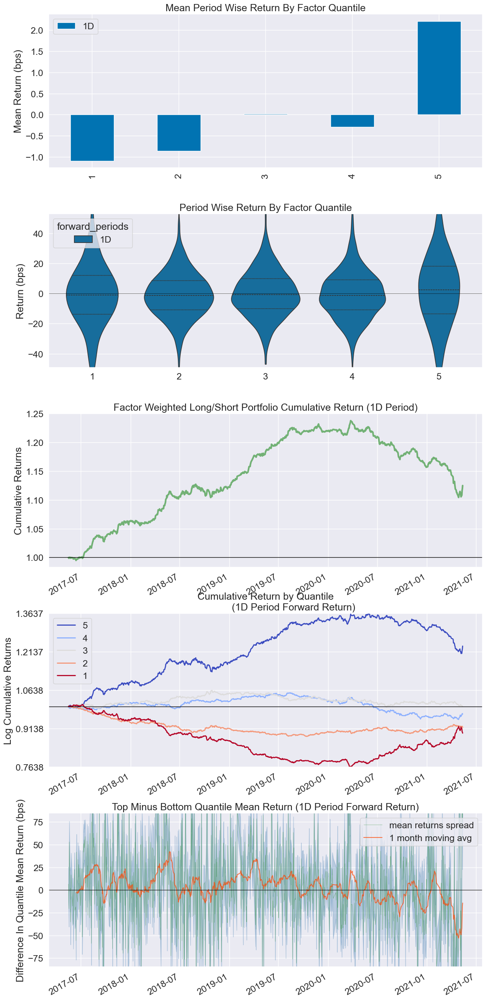

Information Analysis


,1D
IC Mean,0.013
IC Std.,0.066
Risk-Adjusted IC,0.197
t-stat(IC),6.153
p-value(IC),0.000
IC Skew,0.218
IC Kurtosis,0.360


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


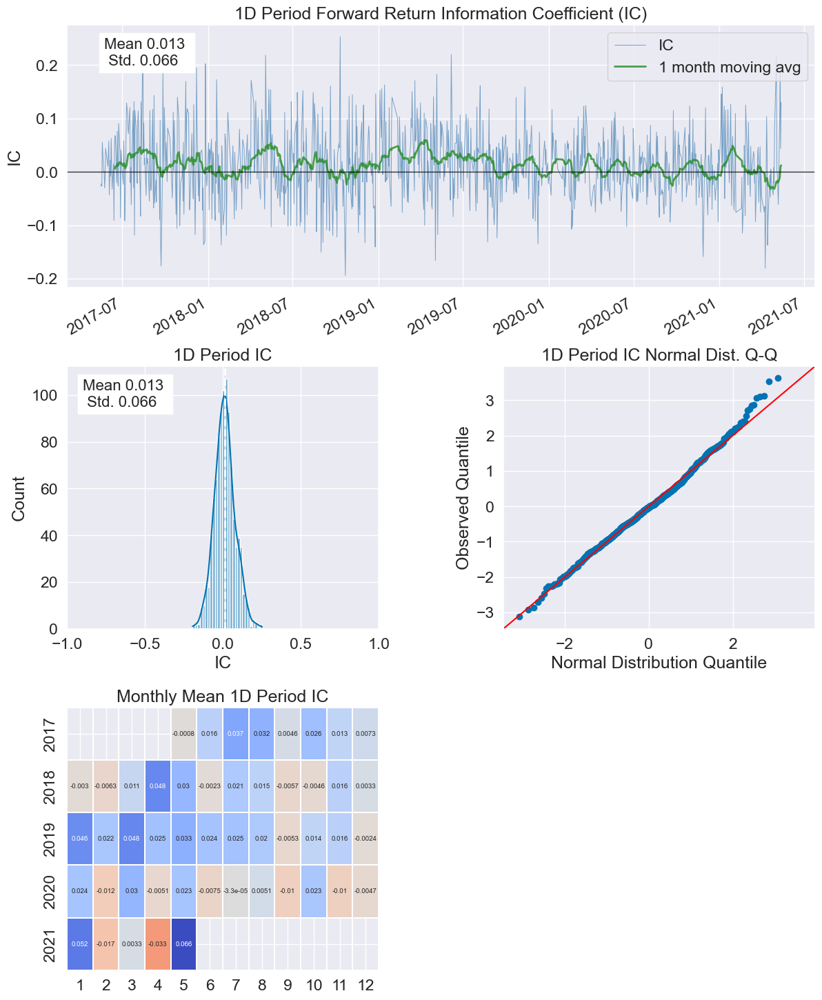

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.005


,1D
Mean Factor Rank Autocorrelation,0.996


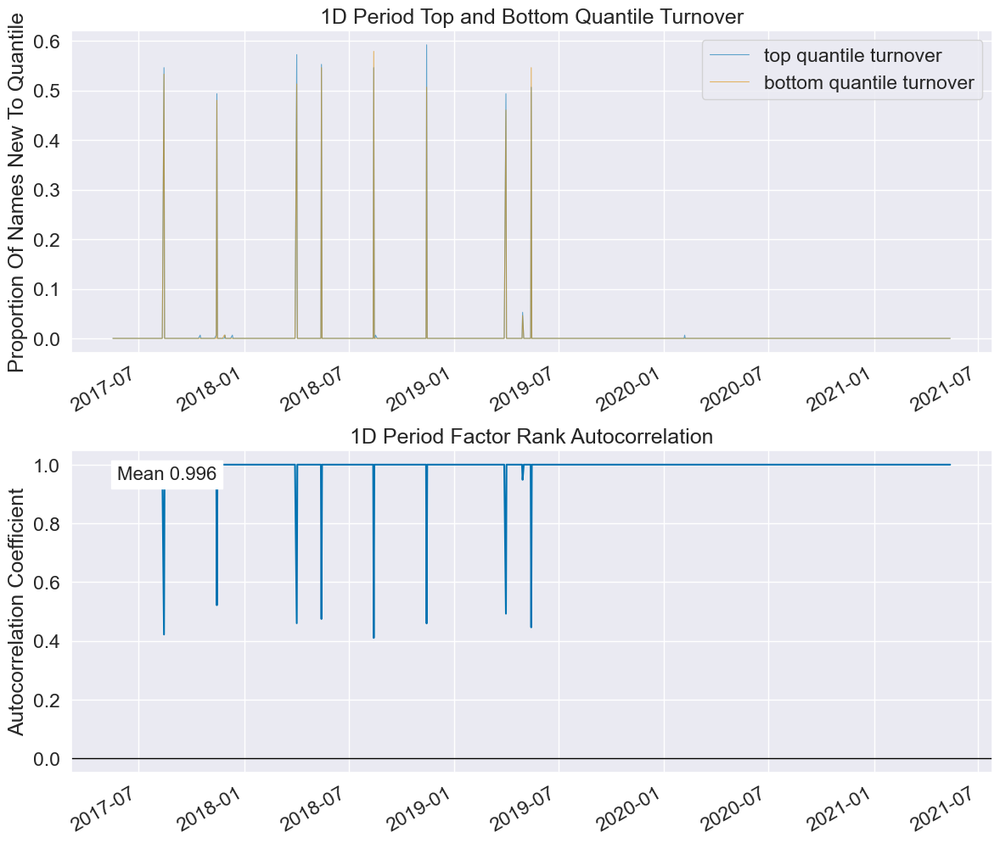

pair: ('營運現金流', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500602,43.878119,147896,20.079424
2,153.0,304.0,228.035146,43.608033,146987,19.956011
3,304.0,455.0,379.036750,43.570326,146859,19.938633
4,455.0,606.0,530.056828,43.618762,147023,19.960899
5,606.0,757.0,681.554097,43.846568,147790,20.065032


Returns Analysis


,1D
Ann. alpha,0.034
beta,0.016
Mean Period Wise Return Top Quantile (bps),2.309
Mean Period Wise Return Bottom Quantile (bps),-1.109
Mean Period Wise Spread (bps),3.418


<Figure size 640x480 with 0 Axes>

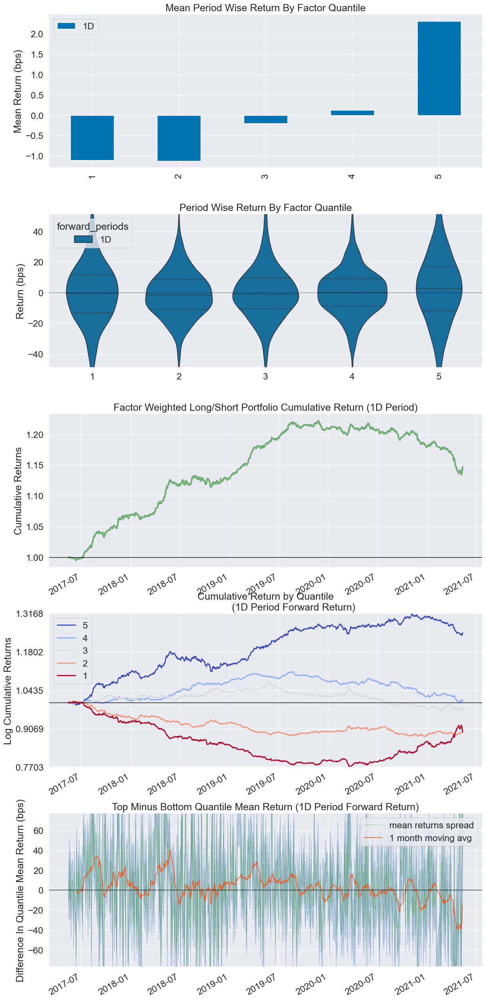

Information Analysis


,1D
IC Mean,0.008
IC Std.,0.061
Risk-Adjusted IC,0.128
t-stat(IC),4.006
p-value(IC),0.000
IC Skew,0.244
IC Kurtosis,0.441


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


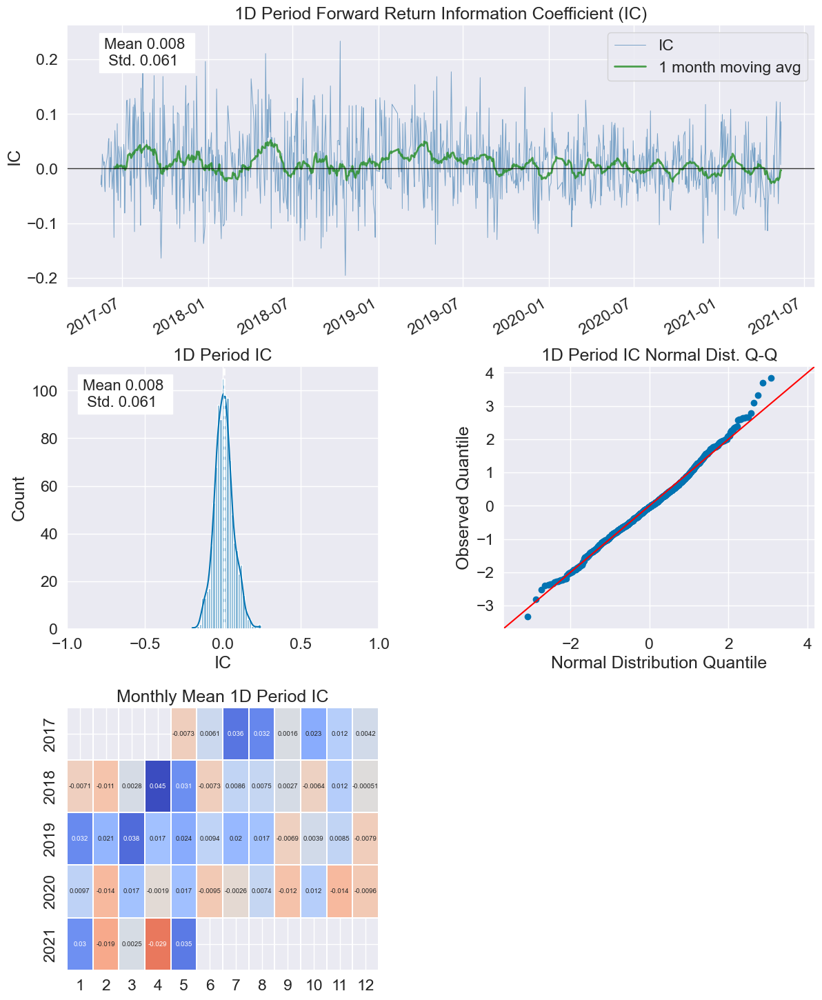

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.995


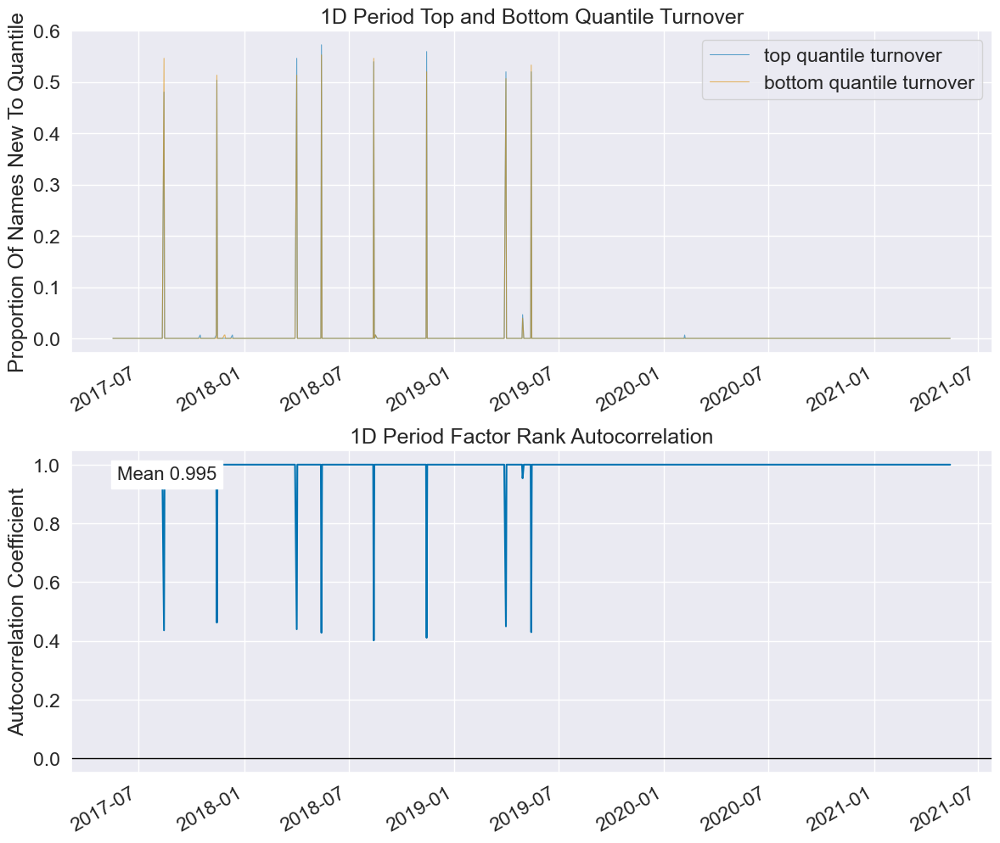

pair: ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.532932,43.896773,147958,20.087841
2,153.0,304.5,228.041574,43.574428,146872,19.940398
3,304.0,455.5,379.011796,43.586155,146914,19.946100
4,455.0,606.0,530.011676,43.591528,146931,19.948408
5,606.0,757.0,681.508169,43.872804,147880,20.077252


Returns Analysis


,1D
Ann. alpha,0.024
beta,-0.014
Mean Period Wise Return Top Quantile (bps),1.616
Mean Period Wise Return Bottom Quantile (bps),-1.085
Mean Period Wise Spread (bps),2.701


<Figure size 640x480 with 0 Axes>

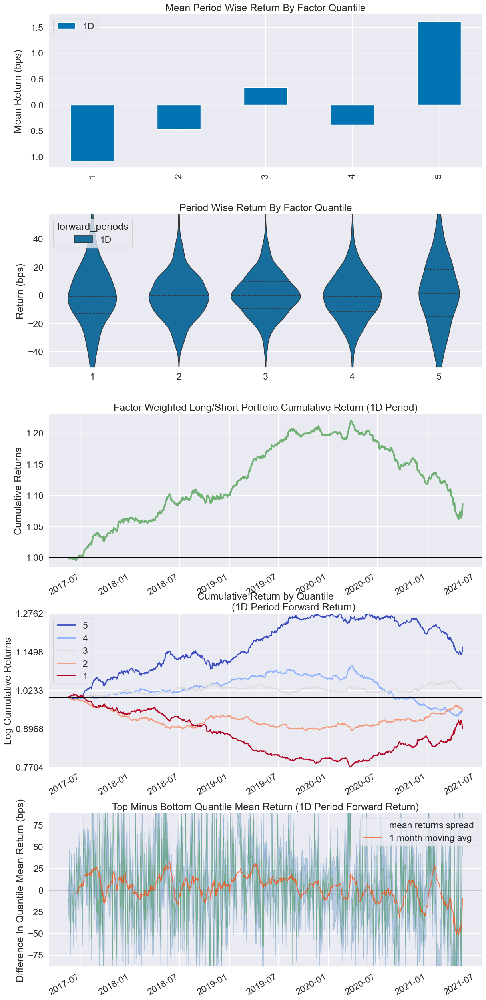

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.072
Risk-Adjusted IC,0.213
t-stat(IC),6.633
p-value(IC),0.000
IC Skew,0.196
IC Kurtosis,0.293


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


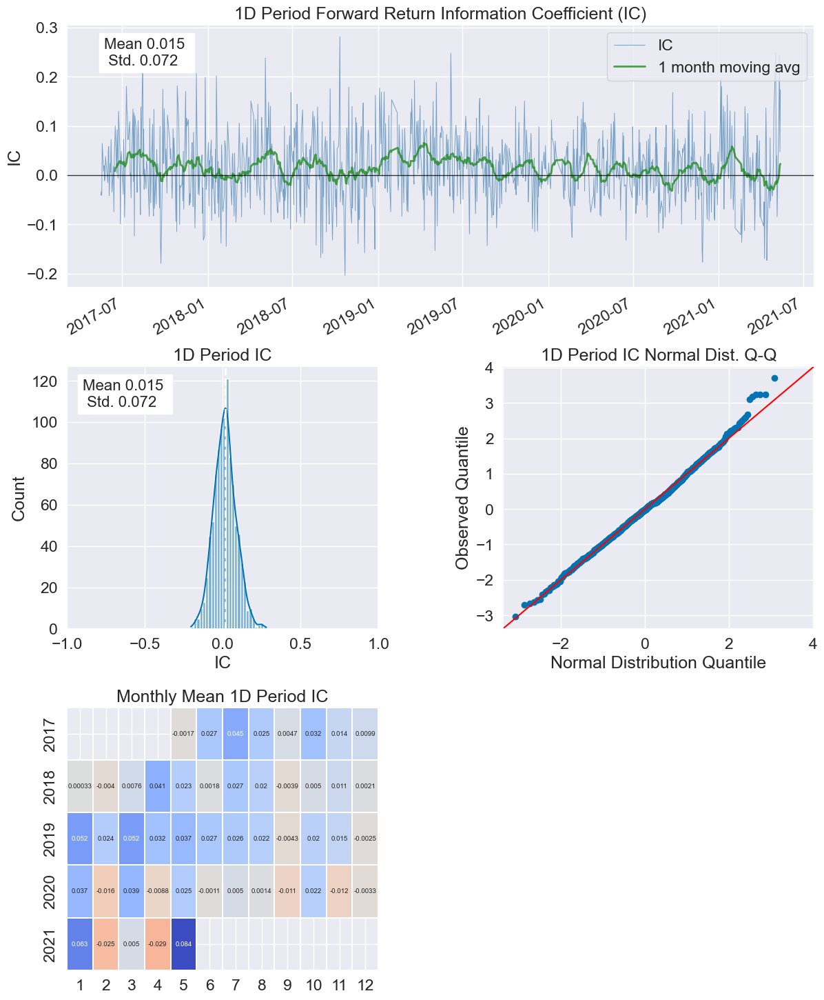

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


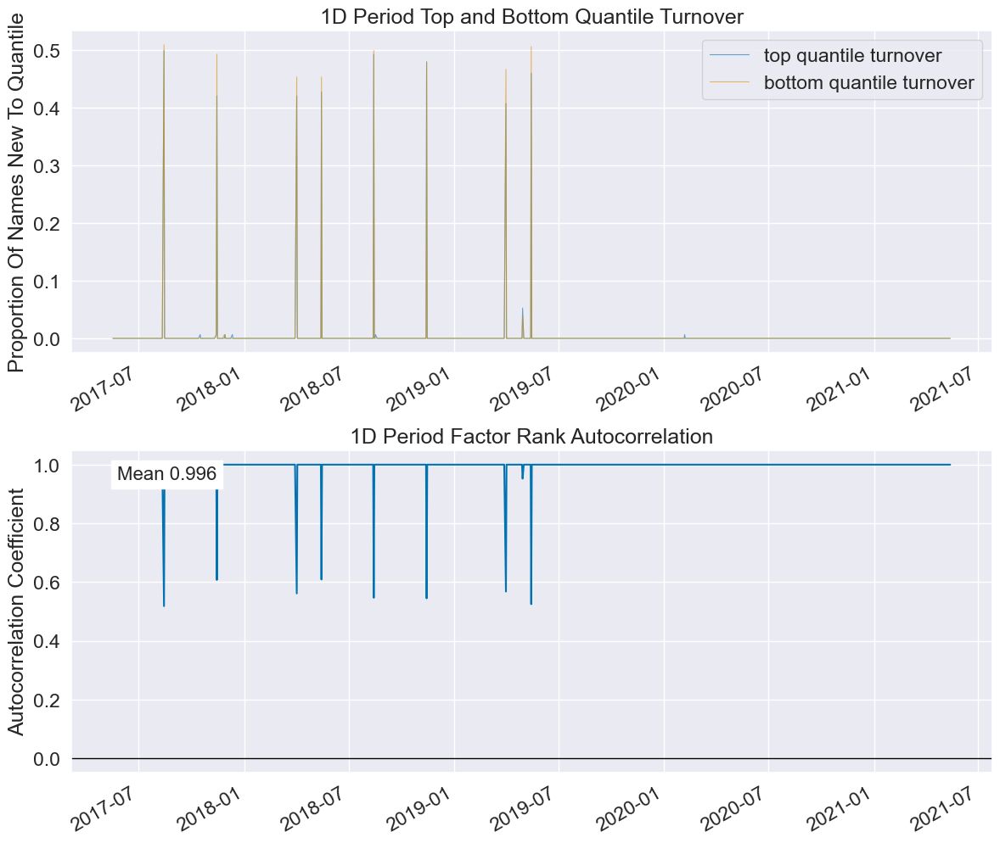

pair: ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '營業利益成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500886,43.878171,147896,20.079424
2,153.0,304.5,228.024734,43.601033,146963,19.952753
3,304.0,455.0,379.025537,43.577141,146883,19.941892
4,455.0,606.0,530.005551,43.589064,146923,19.947322
5,606.0,757.0,681.503063,43.875747,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.023
beta,-0.015
Mean Period Wise Return Top Quantile (bps),1.717
Mean Period Wise Return Bottom Quantile (bps),-0.907
Mean Period Wise Spread (bps),2.624


<Figure size 640x480 with 0 Axes>

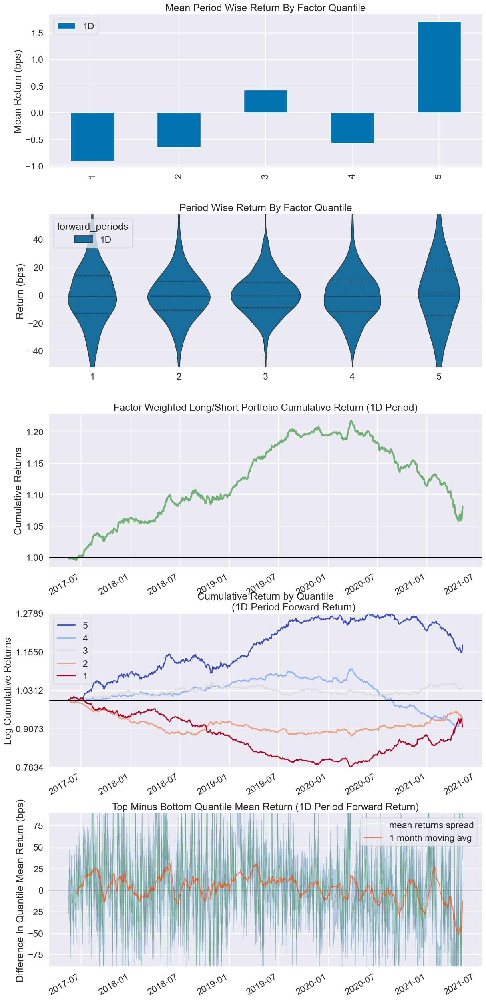

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.072
Risk-Adjusted IC,0.213
t-stat(IC),6.634
p-value(IC),0.000
IC Skew,0.193
IC Kurtosis,0.292


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


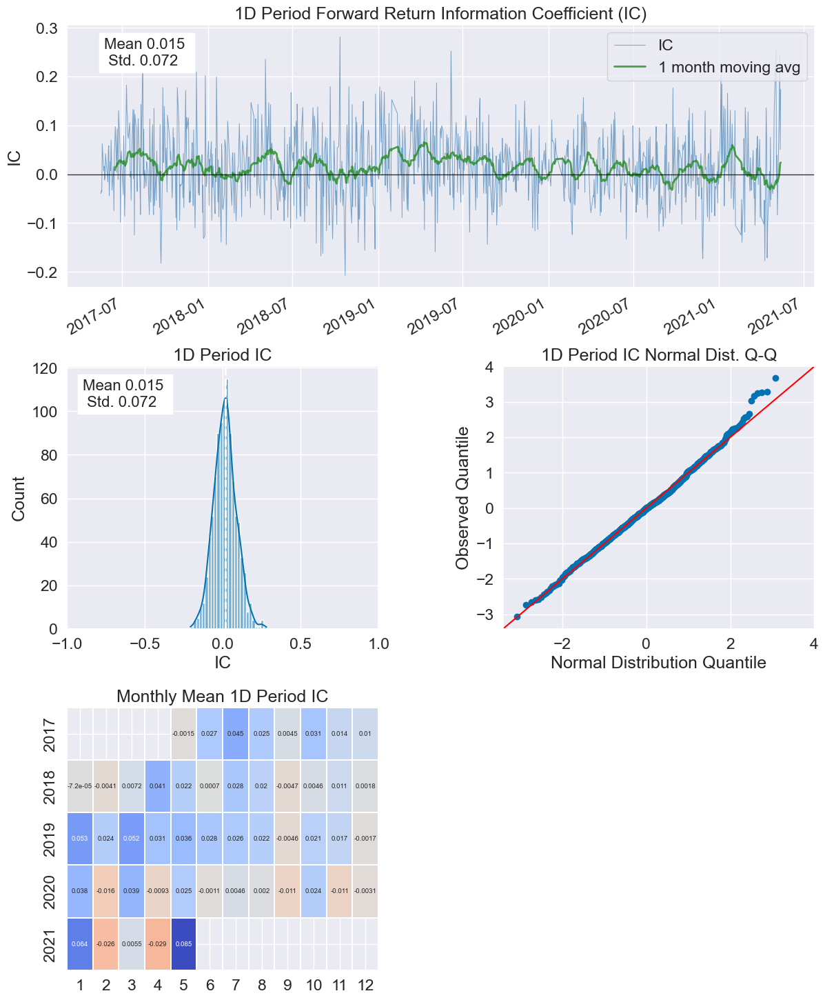

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


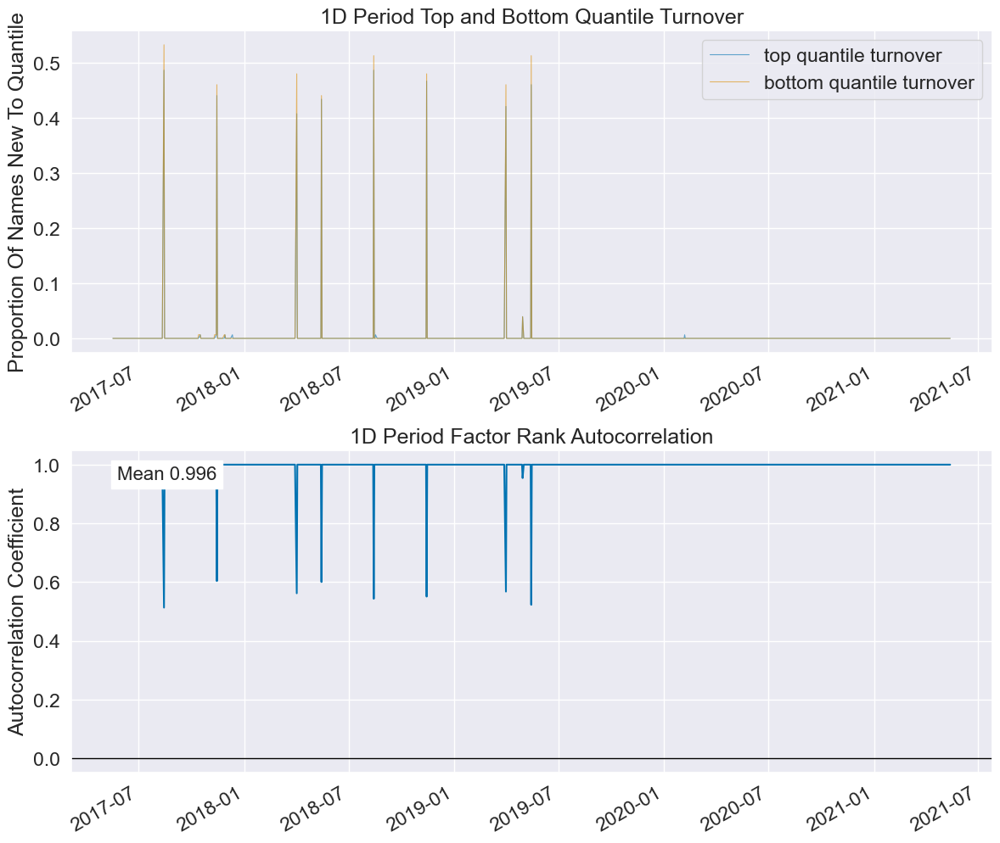

pair: ('歸屬母公司淨利', 'ROE稅後', '營業毛利成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500859,43.877854,147896,20.079424
2,153.0,304.5,228.049391,43.616509,147011,19.959270
3,304.0,455.0,379.050083,43.563159,146835,19.935375
4,455.0,606.5,530.089123,43.638529,147084,19.969181
5,606.0,757.0,681.584916,43.829451,147729,20.056751


Returns Analysis


,1D
Ann. alpha,0.024
beta,-0.011
Mean Period Wise Return Top Quantile (bps),1.730
Mean Period Wise Return Bottom Quantile (bps),-1.071
Mean Period Wise Spread (bps),2.801


<Figure size 640x480 with 0 Axes>

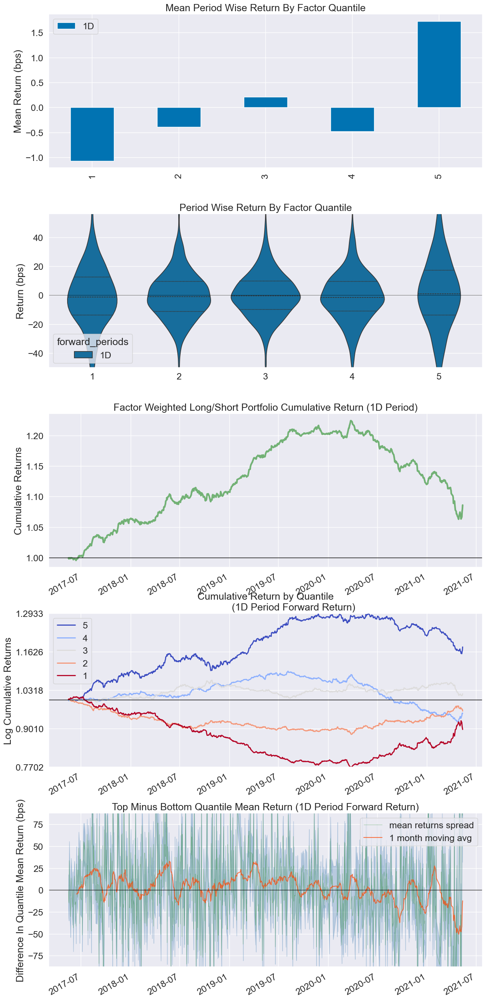

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.072
Risk-Adjusted IC,0.214
t-stat(IC),6.670
p-value(IC),0.000
IC Skew,0.194
IC Kurtosis,0.320


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


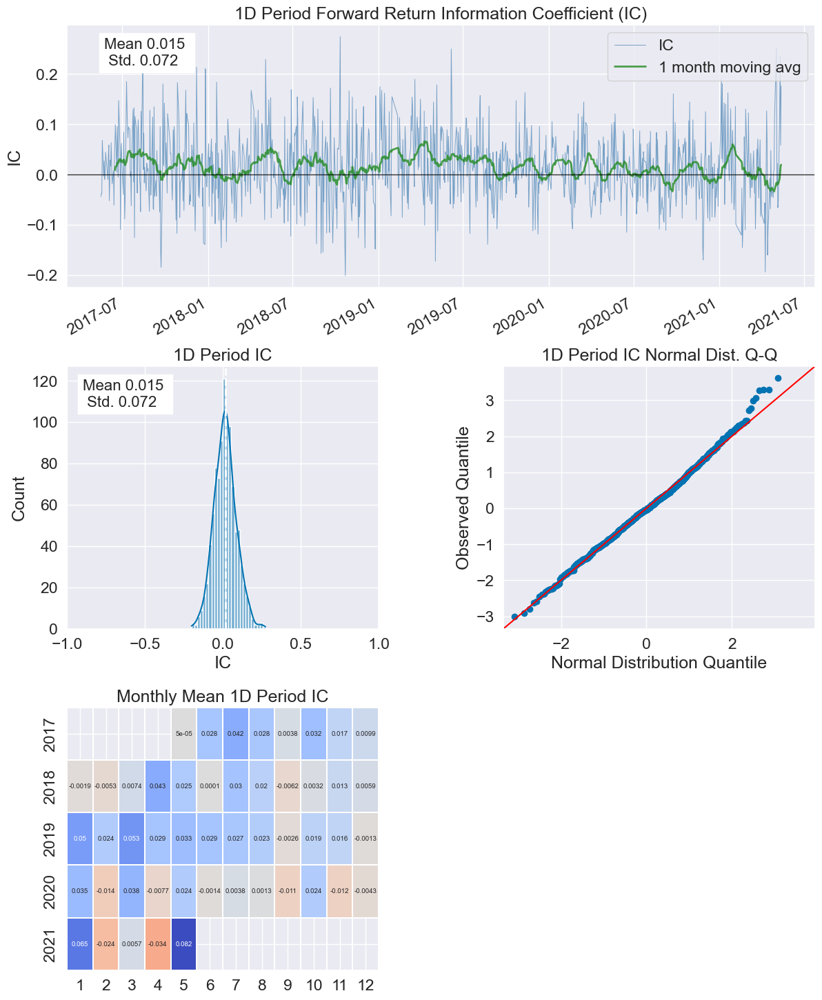

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


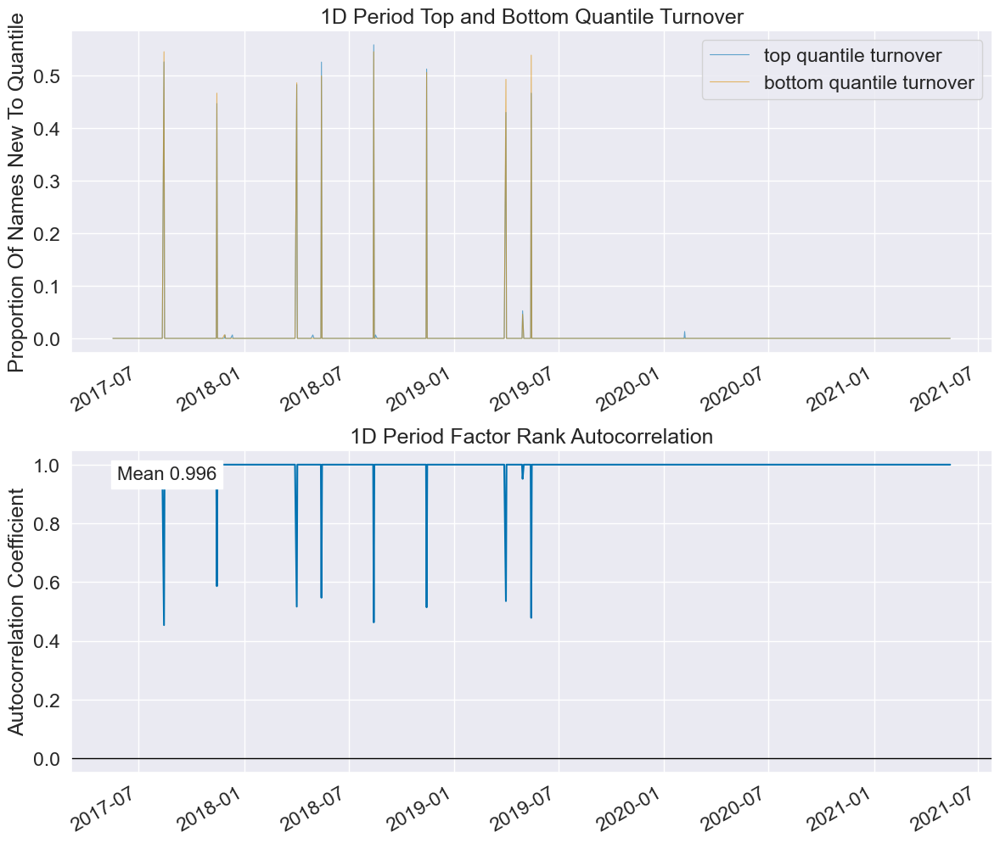

pair: ('歸屬母公司淨利', 'ROE稅後', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500615,43.878060,147896,20.079424
2,153.0,304.5,228.055882,43.621200,147025,19.961171
3,304.0,455.0,379.057233,43.558904,146821,19.933474
4,455.0,606.0,530.005704,43.589030,146923,19.947322
5,606.0,757.0,681.503063,43.875772,147890,20.078609


Returns Analysis


,1D
Ann. alpha,0.026
beta,-0.012
Mean Period Wise Return Top Quantile (bps),1.830
Mean Period Wise Return Bottom Quantile (bps),-1.031
Mean Period Wise Spread (bps),2.860


<Figure size 640x480 with 0 Axes>

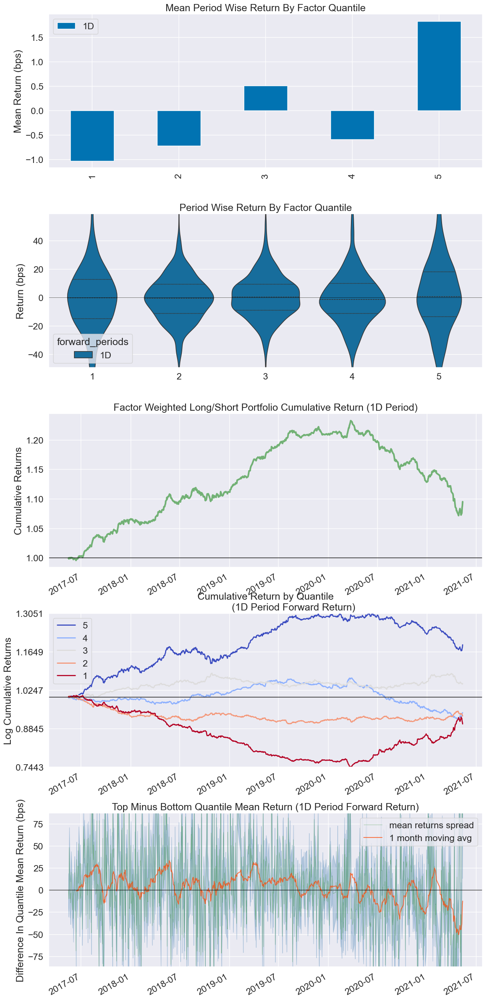

Information Analysis


,1D
IC Mean,0.015
IC Std.,0.071
Risk-Adjusted IC,0.216
t-stat(IC),6.724
p-value(IC),0.000
IC Skew,0.194
IC Kurtosis,0.283


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


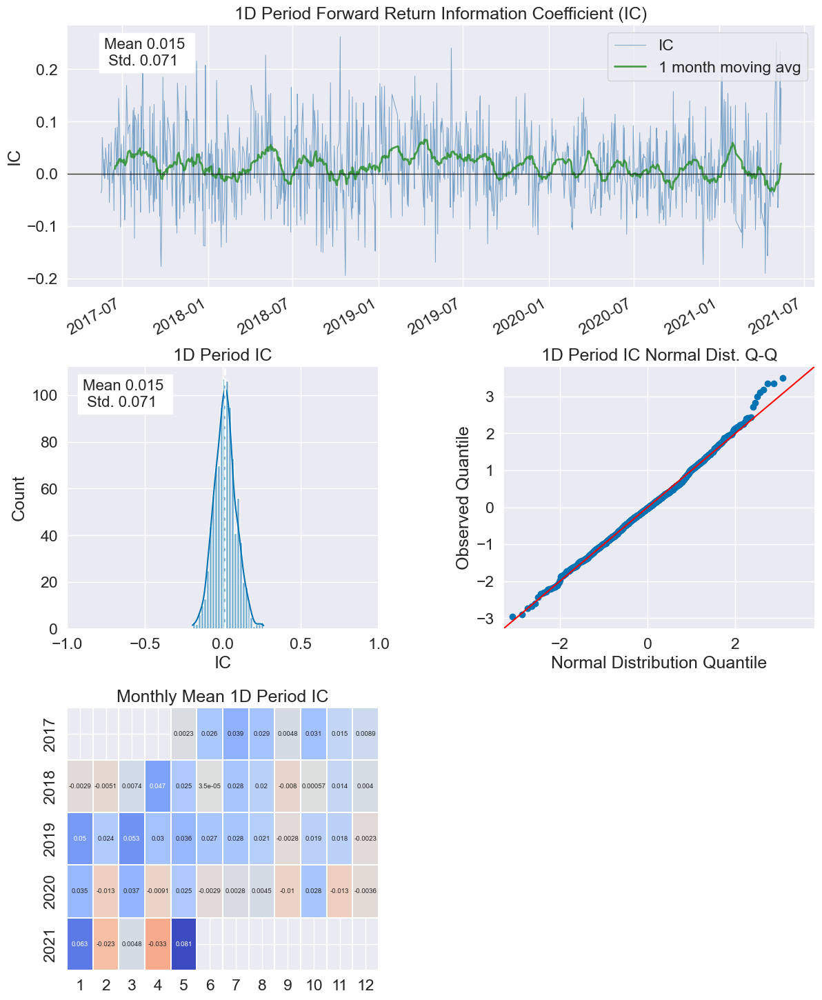

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.996


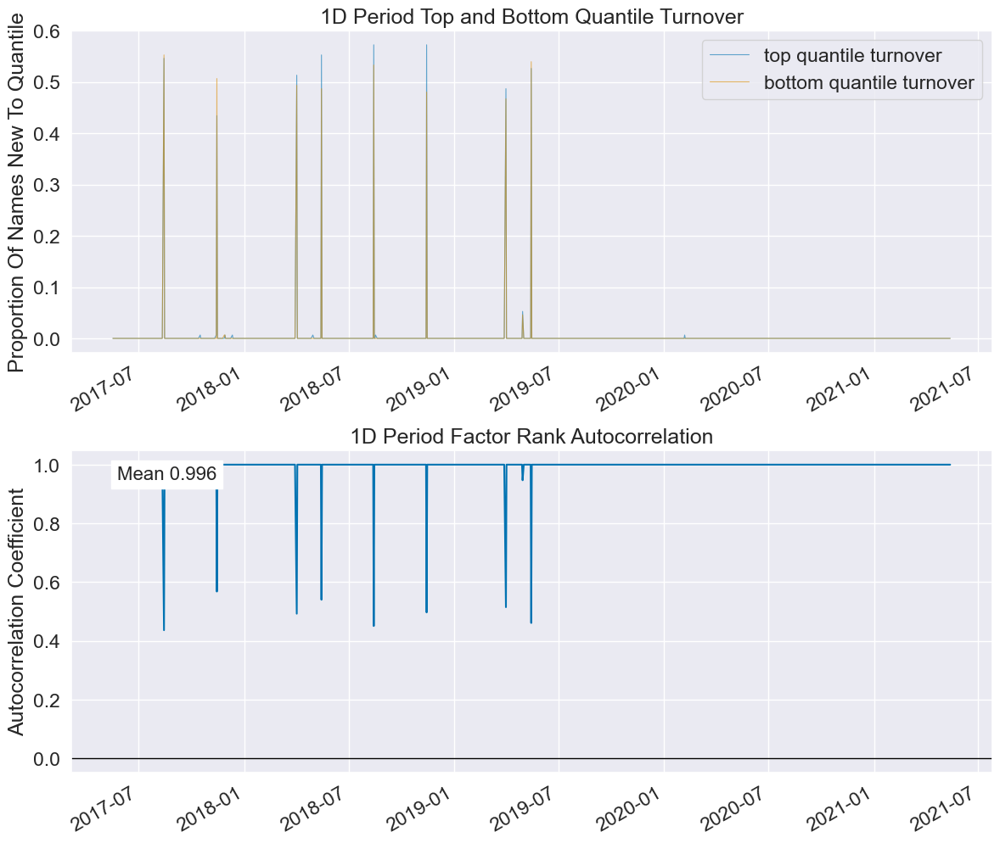

pair: ('歸屬母公司淨利', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500703,43.878243,147896,20.079424
2,153.0,304.5,228.036608,43.609261,146989,19.956283
3,304.0,455.5,379.047537,43.575364,146875,19.940806
4,455.0,606.0,530.069851,43.616224,147012,19.959406
5,606.0,757.0,681.557662,43.844680,147783,20.064082


Returns Analysis


,1D
Ann. alpha,0.030
beta,0.005
Mean Period Wise Return Top Quantile (bps),2.080
Mean Period Wise Return Bottom Quantile (bps),-1.085
Mean Period Wise Spread (bps),3.165


<Figure size 640x480 with 0 Axes>

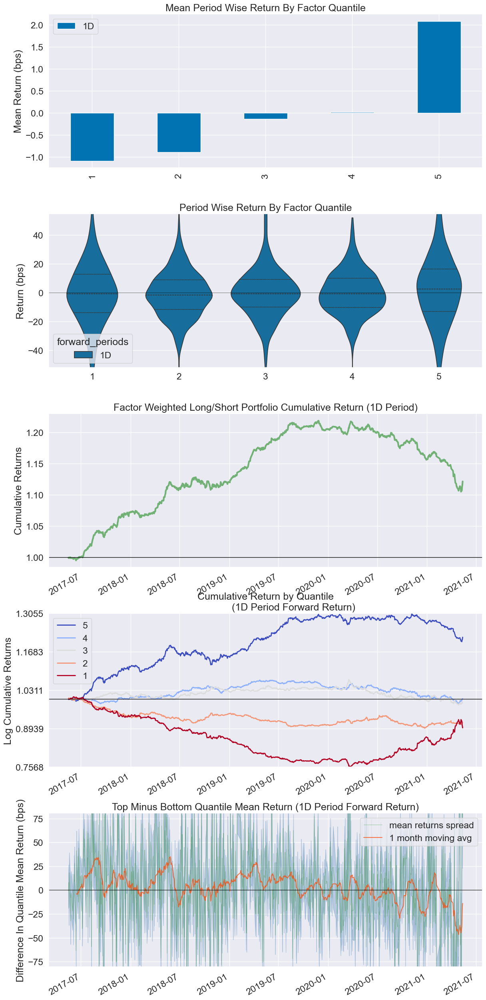

Information Analysis


,1D
IC Mean,0.010
IC Std.,0.064
Risk-Adjusted IC,0.157
t-stat(IC),4.892
p-value(IC),0.000
IC Skew,0.236
IC Kurtosis,0.366


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


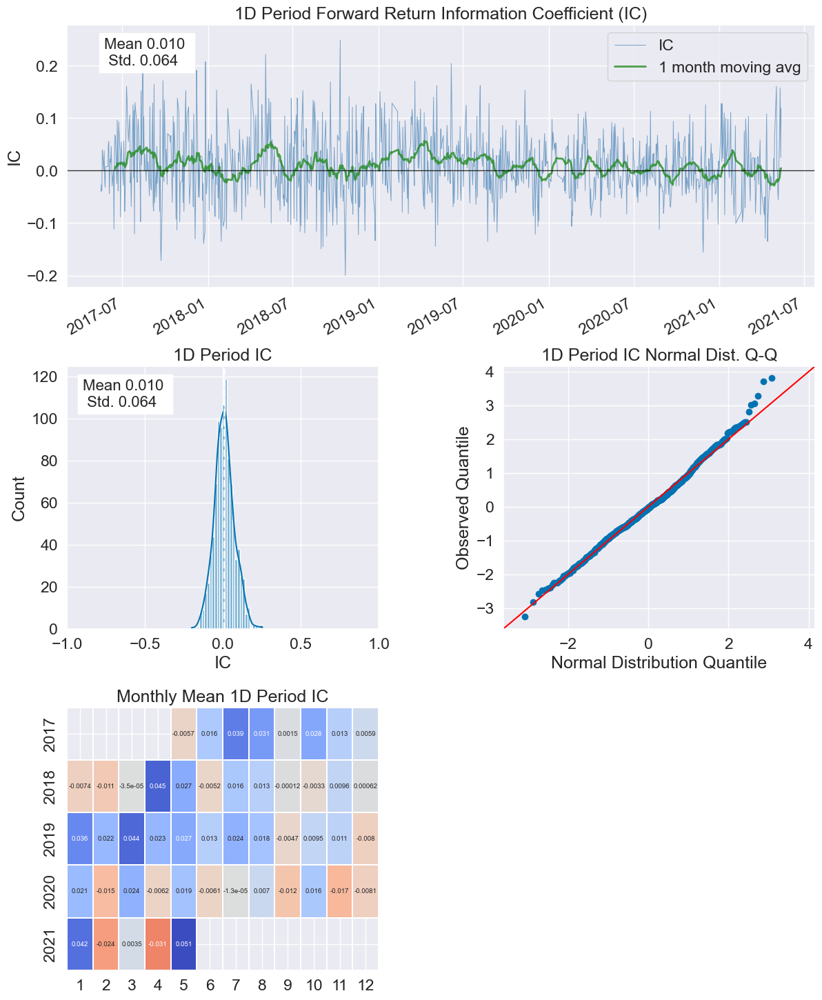

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.995


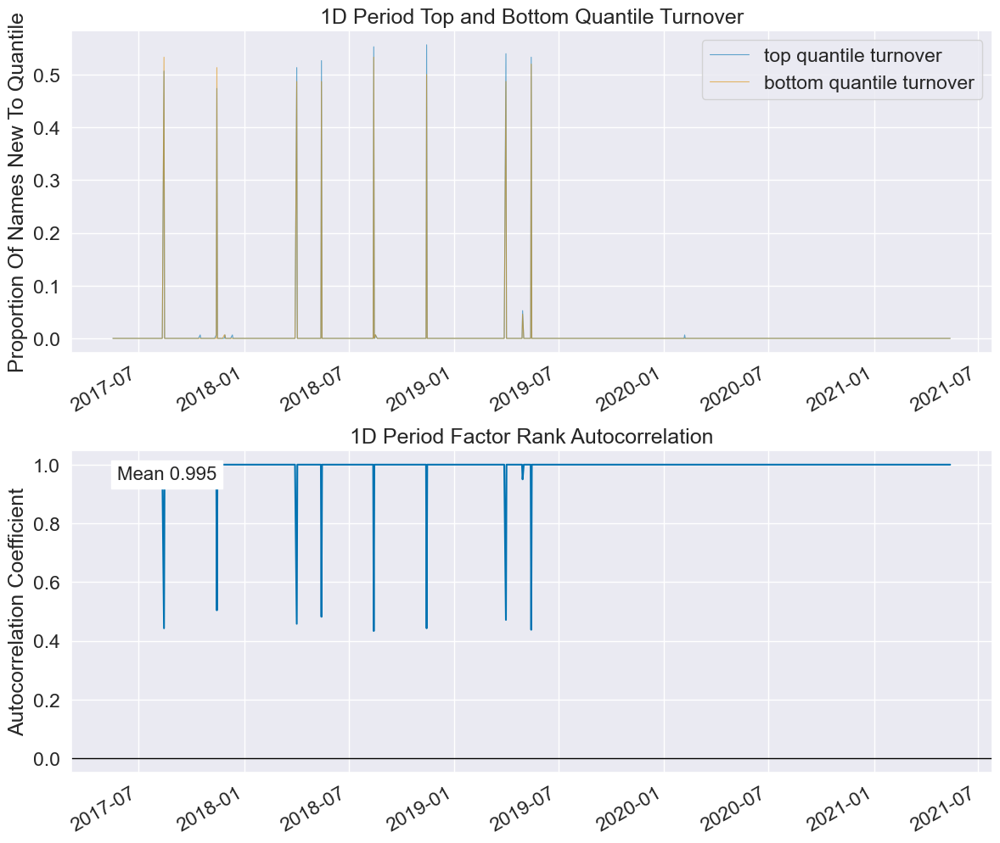

pair: ('ROE稅後', '營業毛利成長率', '營業利益成長率', '稅前淨利成長率', '稅後淨利成長率')
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,1.0,153.0,76.500642,43.878017,147896,20.079424
2,153.0,304.0,228.035731,43.609161,146987,19.956011
3,304.0,455.0,379.046995,43.576281,146878,19.941213
4,455.0,606.0,530.264363,43.728323,147388,20.010454
5,606.0,757.0,681.750641,43.733724,147406,20.012898


Returns Analysis


,1D
Ann. alpha,0.030
beta,0.003
Mean Period Wise Return Top Quantile (bps),1.752
Mean Period Wise Return Bottom Quantile (bps),-1.268
Mean Period Wise Spread (bps),3.019


<Figure size 640x480 with 0 Axes>

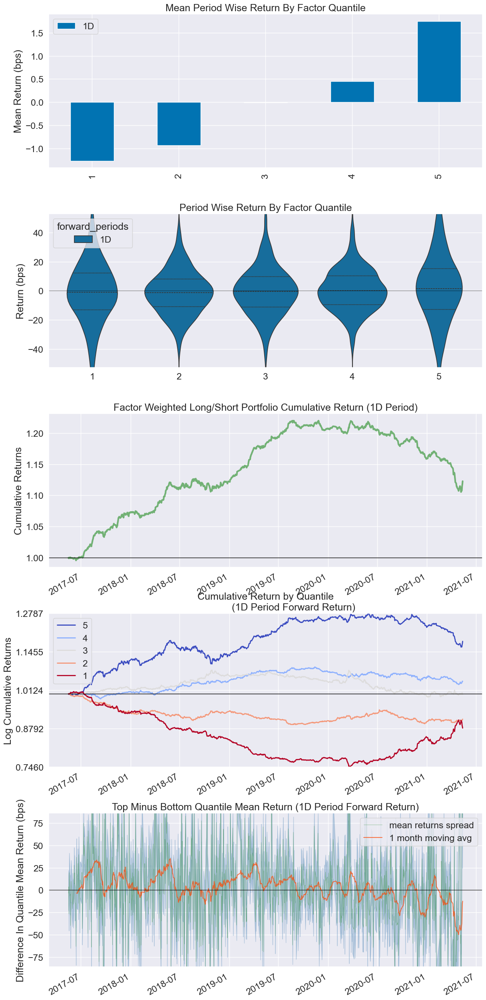

Information Analysis


,1D
IC Mean,0.009
IC Std.,0.064
Risk-Adjusted IC,0.140
t-stat(IC),4.376
p-value(IC),0.000
IC Skew,0.230
IC Kurtosis,0.351


/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


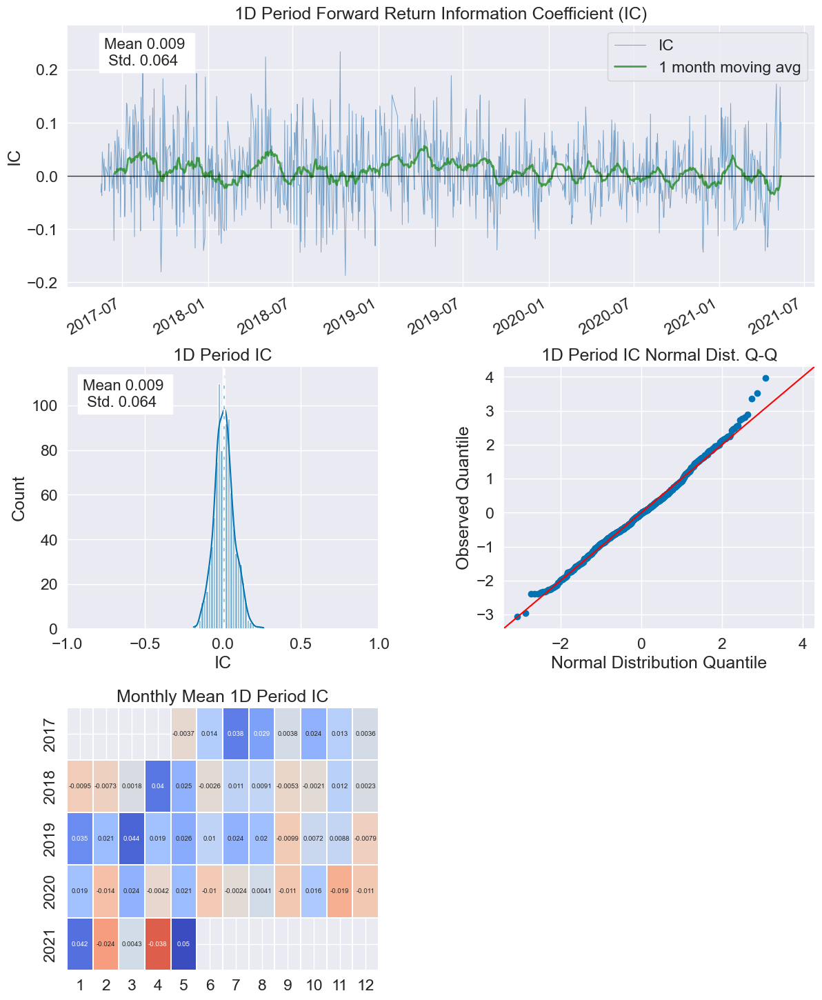

/opt/homebrew/Caskroom/miniforge/base/envs/stock/lib/python3.13/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D
Quantile 1 Mean Turnover,0.004
Quantile 2 Mean Turnover,0.006
Quantile 3 Mean Turnover,0.006
Quantile 4 Mean Turnover,0.006
Quantile 5 Mean Turnover,0.004


,1D
Mean Factor Rank Autocorrelation,0.995


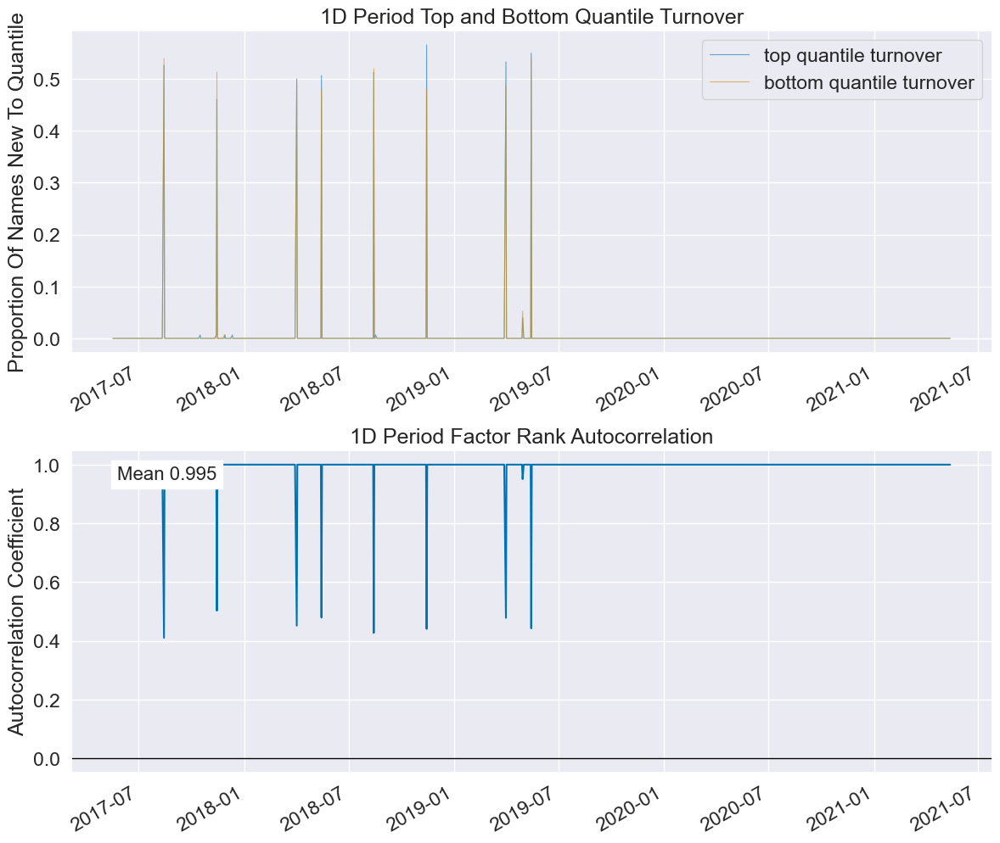

In [32]:
# 使用 Alphalend 進行因子分析
for pair in combined_df_dict:
    print(f"pair: {pair}")
    alphalens_factor_data = get_clean_factor_and_forward_returns(
        factor=combined_df_dict[pair].squeeze(),
        prices=close_price_data,
        periods=(1,),
    )
    create_full_tear_sheet(alphalens_factor_data)